# Summary


## <u>Part 1</u>
The primary challenge in this section is the very long forecast time. Most methods and algorithms will go astray when trying to predict this far out. The data contained several features that were largely irrelevant for the task, and some manipulation was required to get the data into a useful format. 

Analysis of the finalized data revealed a time series comprised of trend, season, and residual components. This, in addition to the long prediction window, led me to choose an ARIMA-based model, SARIMA(Seasonal ARIMA), specifically Statsmodels’ SARIMAX.
A grid search was conducted to find the optimal parameters of the SARIMAX model and then manual tuning was used to achieve the desired results.

## <u>Part 2</u>
Market1 and Market 2 were very similar datasets. The data required very little manipulation, which is typical for financial data. The only steps performed were to split the data (75/25) and normalize the data. I initially winsorized the data at the .01/.99 percentiles, but many of the entities were clipped for the majority of the validation data. This clipping did yield a significant improvement in MSE on the validation set but would have led to very poor forecasting results due to the data being constant for several periods. 

The data was converted into rolling 50-day windows with one prediction per window for training and evaluating the models. This method retains the time-series nature of the data and accurately mimics real-world time series forecasting.

The final predictions were made using an autoregressive method with the same rolling 50 period window making one prediction at a time. The prediction is added to the data to make the next prediction.
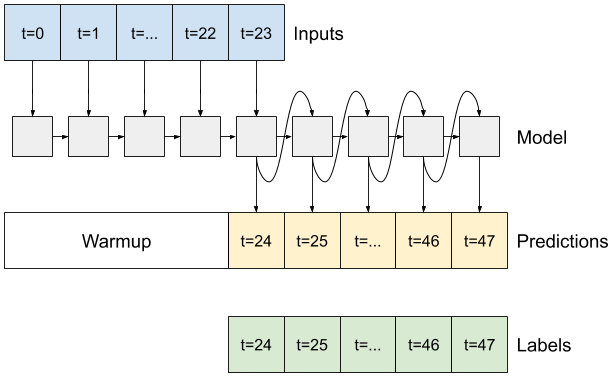


### <u>Market 1</u>
I chose to use an LSTM RNN implemented with TensorFlow for Market 1. The architecture consisted of four LSTM layers, each with dropout, a dense output layer, and rmsprop as the optimizer. The result was a mean MSE of ~0.08 on the validation data for all entities, reasonable for the scope of this project. The model appears as though it performed well on the 20 day forecast window.

### <u>Market 2</u>

In order to facilitate the reuse of code, I chose to stick with TensorFlow and use a GRU model for market 2. The model architecture consists of four GRU layers each with a dropout, and a dense output layer. I initially used SGD as the optimizer but the gradients exploded on the final model so I switched to rmsprop. I also experimented with a cyclical learning rate callback (https://arxiv.org/abs/1506.01186) and gradient clipping (https://papers.nips.cc/paper/2017/file/f2fc990265c712c49d51a18a32b39f0c-Paper.pdf). This model initially yielded a mean MSE of ~0.004 on the validation data for all entities, but performed poorly on the 20 day test window. The final model yielded a score of 0.1351 on the validation data, but appears to have performed well on the 20 day forecast window.

### <u>To Do</u>
- Modularity; the code needs to be organized into functions and classes 
- improve code efficiency, there is too much indexing
- annotate code
- tune the GRU model

# Imports

In [5]:
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

In [6]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.tsa.api as tsa
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import numpy as np
import itertools
from numpy import inf
from sklearn.metrics import mean_squared_error
import gc

sns.set_style('whitegrid')
np.random.seed(4321)

In [7]:
import tensorflow as tf
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, LSTM, GRU, Input, concatenate, Embedding, Reshape, BatchNormalization, Dropout 
from tensorflow.keras.optimizers import SGD
import TimeSeriesHelpers as tsh

SEED = 4321
np.random.seed(SEED)
tf.random.set_seed(SEED)

#Check GPU
physical_devices = tf.config.list_physical_devices('GPU')
print('TF version:',tf.__version__ ,  tf.test.gpu_device_name() )

#memory control 
tf.config.experimental.set_memory_growth(physical_devices[0], True)

TF version: 2.6.0 /device:GPU:0


# Helper Functions

# Part 1

crime_2020.csv and crime_2021.csv contain real data on crime in Boston. Predict the number of vandalism incidents and the number of verbal disputes (OFFENSE_DESCRIPTION=="VANDALISM" or OFFENSE_DESCRIPTION=="VERBAL DISPUTE") for each day from July 9, 2021 to December 31, 2021. Save your predictions to a csv named crime_pred.csv, with the following format:

| Date | VANDALISM | VERBAL DISPUTE |
| --- | --- | --- |
| 2021-07-09 | prediction | prediction |
| --- | --- | --- |

Obviously, we can't assess your actual prediction accuracy. We will focus on your modeling decisions.

In [4]:
crime_2021 = pd.read_csv('data/crime_2021.csv')
crime_2021 = crime_2021[(crime_2021['OFFENSE_DESCRIPTION']=="VANDALISM") | (crime_2021['OFFENSE_DESCRIPTION']=="VERBAL DISPUTE")]
crime_2021.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
4,212996778,3301,NaN,VERBAL DISPUTE,C6,204,0,2021-02-01 06:20:00,2021,2,Monday,6,NaN,GILLETTE PARK,42.344125,-71.056853,"(42.3441248392933, -71.0568533916328)"
27,212046473,3301,NaN,VERBAL DISPUTE,E18,516,0,2021-07-07 23:53:00,2021,7,Wednesday,23,NaN,NEPONSET AVE,42.296207,-71.054879,"(42.2962066695049, -71.0548785223855)"
40,212046455,3301,NaN,VERBAL DISPUTE,C6,207,0,2021-07-07 21:44:00,2021,7,Wednesday,21,NaN,SEAPORT BLVD,42.350827,-71.043418,"(42.3508268662159, -71.0434175813107)"
63,212046420,1402,NaN,VANDALISM,D4,150,0,2021-07-07 02:41:00,2021,7,Wednesday,2,NaN,APPLETON ST,42.345394,-71.073802,"(42.3453940583975, -71.0738024655648)"
81,212046396,3301,NaN,VERBAL DISPUTE,B2,183,0,2021-07-07 17:38:00,2021,7,Wednesday,17,NaN,DUDLEY ST,42.319871,-71.070963,"(42.3198707618137, -71.0709626304778)"


In [5]:
# get a quick overview of the data
crime_2021.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2467 entries, 4 to 34897
Data columns (total 17 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   INCIDENT_NUMBER      2467 non-null   object 
 1   OFFENSE_CODE         2467 non-null   int64  
 2   OFFENSE_CODE_GROUP   0 non-null      float64
 3   OFFENSE_DESCRIPTION  2467 non-null   object 
 4   DISTRICT             2409 non-null   object 
 5   REPORTING_AREA       2467 non-null   object 
 6   SHOOTING             2467 non-null   int64  
 7   OCCURRED_ON_DATE     2467 non-null   object 
 8   YEAR                 2467 non-null   int64  
 9   MONTH                2467 non-null   int64  
 10  DAY_OF_WEEK          2467 non-null   object 
 11  HOUR                 2467 non-null   int64  
 12  UCR_PART             0 non-null      float64
 13  STREET               2443 non-null   object 
 14  Lat                  2467 non-null   float64
 15  Long                 2467 non-null   

## Data Exploration and Manipulation


### Convert OCCURRED_ON_DATE to datetime, sort data, and change the  index to datetime
> OCCURRED_ON_DATE is currently an object therefore it must be converted to datetime and sorted. 

In [6]:
crime_2021['OCCURRED_ON_DATE'] = pd.to_datetime(crime_2021['OCCURRED_ON_DATE'])                      #Convert to datetime
crime_2021.sort_values(by=['OCCURRED_ON_DATE'], inplace=True, ascending=True, ignore_index = True)   #sort by date
crime_2021.index = crime_2021['OCCURRED_ON_DATE']                                                    #change index to datetime
crime_2021.tail()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
OCCURRED_ON_DATE,,,,,,,,,,,,,,,,,
2021-07-07 12:03:00,212046300,1402,NaN,VANDALISM,B3,426,0,2021-07-07 12:03:00,2021,7,Wednesday,12,NaN,BLUE HILL AVE,42.269859,-71.093464,"(42.2698591613484, -71.0934635332552)"
2021-07-07 16:15:00,212046373,3301,NaN,VERBAL DISPUTE,E5,691,0,2021-07-07 16:15:00,2021,7,Wednesday,16,NaN,CENTRE ST,42.287094,-71.148221,"(42.2870935525911, -71.1482212837716)"
2021-07-07 17:38:00,212046396,3301,NaN,VERBAL DISPUTE,B2,183,0,2021-07-07 17:38:00,2021,7,Wednesday,17,NaN,DUDLEY ST,42.319871,-71.070963,"(42.3198707618137, -71.0709626304778)"
2021-07-07 21:44:00,212046455,3301,NaN,VERBAL DISPUTE,C6,207,0,2021-07-07 21:44:00,2021,7,Wednesday,21,NaN,SEAPORT BLVD,42.350827,-71.043418,"(42.3508268662159, -71.0434175813107)"
2021-07-07 23:53:00,212046473,3301,NaN,VERBAL DISPUTE,E18,516,0,2021-07-07 23:53:00,2021,7,Wednesday,23,NaN,NEPONSET AVE,42.296207,-71.054879,"(42.2962066695049, -71.0548785223855)"


In [7]:
#check the unique counts by column

tsh.print_unique(crime_2021)

INCIDENT_NUMBER     	2467
OFFENSE_CODE        	   2
OFFENSE_CODE_GROUP  	   1
OFFENSE_DESCRIPTION 	   2
DISTRICT            	  14
REPORTING_AREA      	 612
SHOOTING            	   2
OCCURRED_ON_DATE    	2414
YEAR                	   1
MONTH               	   7
DAY_OF_WEEK         	   7
HOUR                	  24
UCR_PART            	   1
STREET              	1012
Lat                 	1572
Long                	1572
Location            	1572


In [8]:
#A closer look at SHOOTING because it only has two unique values

crime_2021['SHOOTING'].value_counts()

0    2422
1      45
Name: SHOOTING, dtype: int64

### Drop Unused Columns
> - The problem statement asks for the number of incidents, not the location, so all location data will be dropped.
> - SHOOTING is too sparse to add any value to this particular task.
> - UCR_PART and OFFENSE_CODE_GROUP only contain a single value.
> - Other time columns do not contain any additional information.
#### This becomes a univariate time series.

In [9]:
cols_to_drop = ['INCIDENT_NUMBER', 'OFFENSE_CODE_GROUP','OFFENSE_DESCRIPTION', 'DISTRICT', 'REPORTING_AREA', \
                'SHOOTING', 'OCCURRED_ON_DATE', 'YEAR', 'MONTH', 'DAY_OF_WEEK', 'HOUR', 'UCR_PART', 'STREET', \
                'Lat', 'Long', 'Location']

crime_2021.drop(cols_to_drop, axis = 1, inplace = True)
crime_2021.head(3)

,OFFENSE_CODE
OCCURRED_ON_DATE,
2021-01-01 00:00:00,1402
2021-01-01 00:00:00,1402
2021-01-01 03:25:00,1402


### Split Data and Resample to Daily
> Split the data by offense code and resample the data to daily count

In [10]:
crime_2021_VANDALISM = crime_2021[crime_2021['OFFENSE_CODE'] == 1402]
crime_2021_VERBAL = crime_2021[crime_2021['OFFENSE_CODE'] == 3301]

crime_2021_VANDALISM = crime_2021_VANDALISM.resample('d').count()
crime_2021_VERBAL = crime_2021_VERBAL.resample('d').count()

crime_2021_VANDALISM.head()

,OFFENSE_CODE
OCCURRED_ON_DATE,
2021-01-01,9
2021-01-02,11
2021-01-03,6
2021-01-04,3
2021-01-05,5


In [11]:
crime_2021_VERBAL.head()

,OFFENSE_CODE
OCCURRED_ON_DATE,
2021-01-01,4
2021-01-02,2
2021-01-03,5
2021-01-04,3
2021-01-05,4


In [12]:
#Rename columns and concatenate

crime_2021_VANDALISM.rename(columns = {'OFFENSE_CODE':'VANDALISM'}, inplace = True)
crime_2021_VERBAL.rename(columns = {'OFFENSE_CODE':'VERBAL_DISPUTE'}, inplace = True)

crime_2021_clean = pd.concat([crime_2021_VANDALISM, crime_2021_VERBAL], axis = 1)
crime_2021_clean.tail()

,VANDALISM,VERBAL_DISPUTE
OCCURRED_ON_DATE,,
2021-07-03,10,2
2021-07-04,13,3
2021-07-05,15,9
2021-07-06,5,5
2021-07-07,4,5


### EDA

#### The data appears to be stationary with a seasonal pattern, possibly weekly and/or monthly. It is not clear if there is a linear trend.

In [13]:
fig = px.line(crime_2021_clean, x=crime_2021_clean.index, y=['VANDALISM', 'VERBAL_DISPUTE'])

fig.show()

#### The data appears to be comprised of trend, seasonal, and residuals.
#### I will use Satsmodels tsa to decompose the data and verify my theory.

vandalism_components = tsa.seasonal_decompose(crime_2021_clean['VANDALISM'], model='additive')
verbal_components = tsa.seasonal_decompose(crime_2021_clean['VERBAL_DISPUTE'], model='additive')

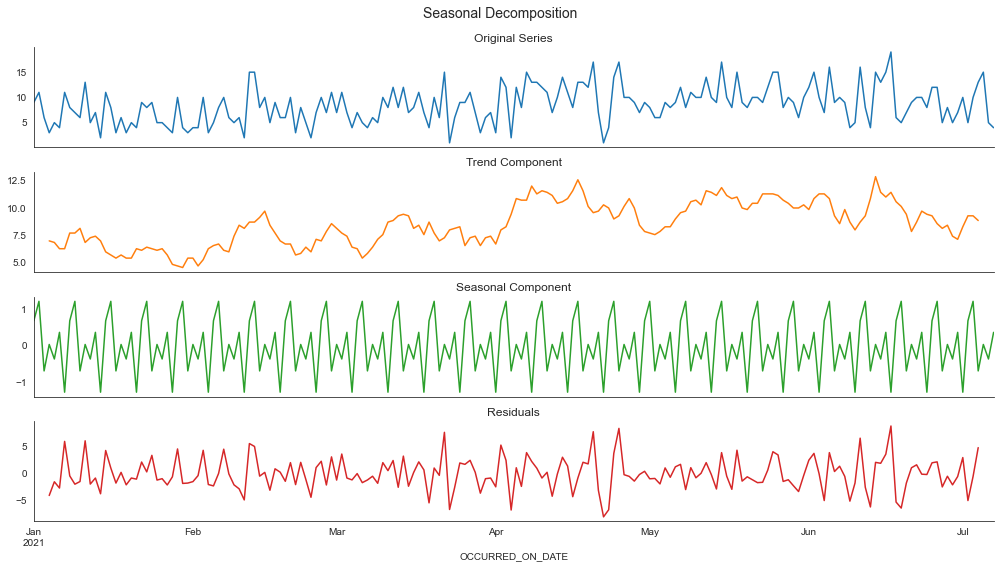

In [14]:
#Check VANDALISM

tsh.plot_decomposition(crime_2021_clean['VANDALISM'])

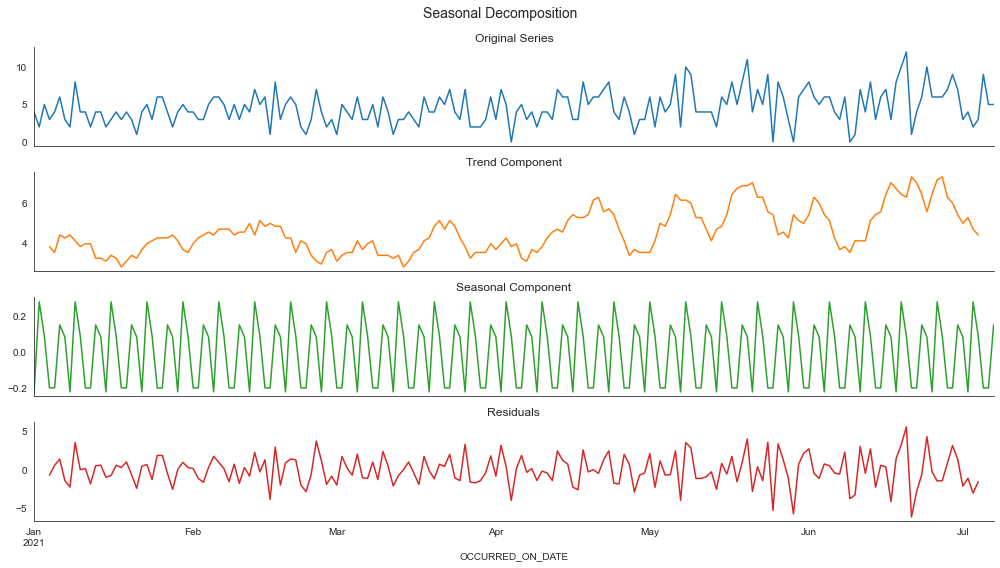

In [15]:
#Check VERBAL_DISPUTE

tsh.plot_decomposition(crime_2021_clean['VERBAL_DISPUTE'])

### Check the Correlation 
> VANDALISM and VERBAL_DISPUTE have low correlation so two seperate models will be used.

In [16]:
crime_2021_clean.corr()

,VANDALISM,VERBAL_DISPUTE
VANDALISM,1.000000,0.089148
VERBAL_DISPUTE,0.089148,1.000000


### Dickey-Fuller Test for Stationarity
> This test will determine if further data manipulation steps are necessary

In [17]:
tsh.dickey_fuller(crime_2021_clean['VANDALISM'])

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [18]:
tsh.dickey_fuller(crime_2021_clean['VERBAL_DISPUTE'])

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

### Check autocorrelation to determine seasonality

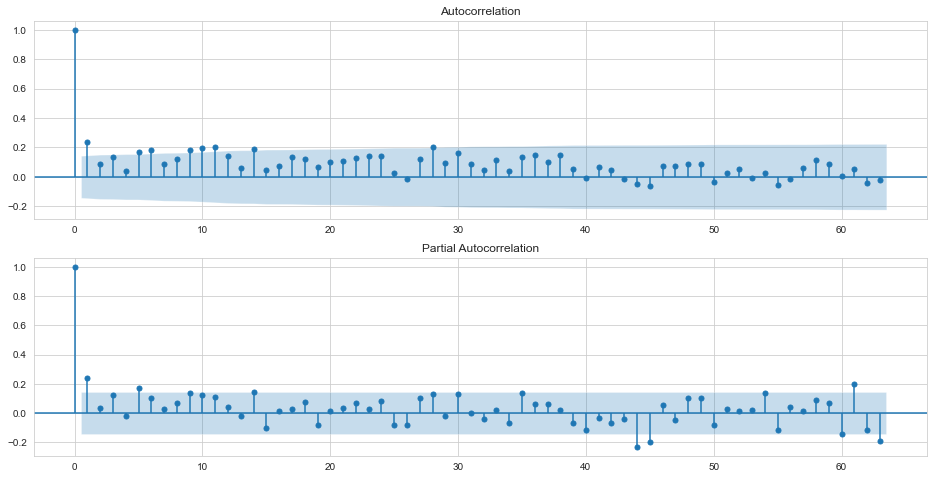

In [23]:
#VANDALISM

fig = plt.figure(figsize=(16,8))
ax1 = fig.add_subplot(211)
fig = plot_acf(crime_2021_clean['VANDALISM'],lags=63,ax=ax1)
ax2 = fig.add_subplot(212)
fig = plot_pacf(crime_2021_clean['VANDALISM'],lags=63,ax=ax2)

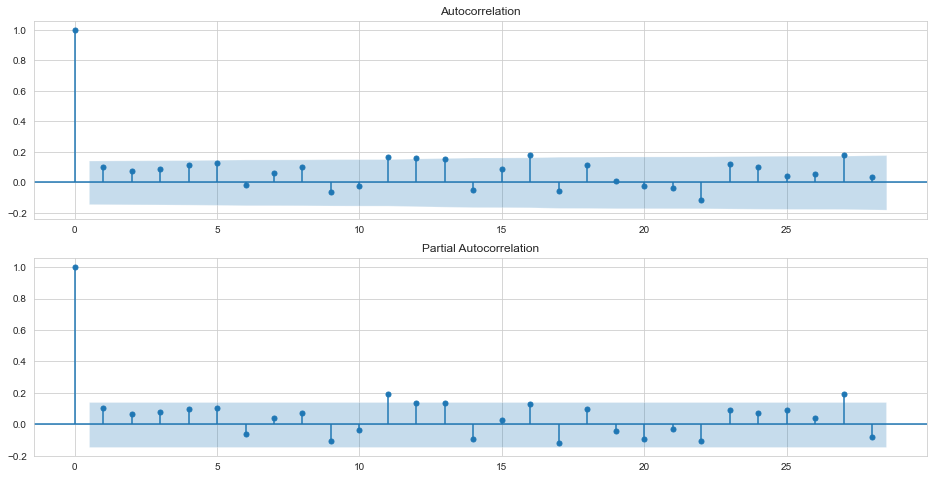

In [24]:
#VERBAL_DISPUTE

fig = plt.figure(figsize=(16,8))
ax1 = fig.add_subplot(211)
fig = plot_acf(crime_2021_clean['VERBAL_DISPUTE'],lags=28,ax=ax1)
ax2 = fig.add_subplot(212)
fig = plot_pacf(crime_2021_clean['VERBAL_DISPUTE'],lags=28,ax=ax2)

### Log Transformation
>Transform the data for use in a SARIMA model

In [25]:
vandalism_log = np.log(crime_2021_clean['VANDALISM'])
verbal_log = np.log(crime_2021_clean['VERBAL_DISPUTE'])
verbal_log[verbal_log == -inf]=0    #some values were zero before log

## Model
> SARIMAX
>
>The seasonality of the data and the long prediction window led me to choose a SARIMA model, specifically Statsmodels' SARIMAX

### Find the parameters of the SARIMAX Model
> A grid search is used to determine the ideal parameters of the model. This is very time consuming and often yields mediocre results, but a good starting point

### Parameter Grid Search

In [26]:
#Vandalism Grid Search

vandalism_params_aic, vandalism_params_bic = tsh.sarimax_grid_search(vandalism_log, max_iter = 300, n_season = 14)
print(vandalism_params_aic)
print(vandalism_params_bic)

           pdq           pdqs         aic         bic
380  (1, 1, 2)  (0, 0, 2, 14)  274.261142  293.647793
           pdq           pdqs         aic         bic
108  (0, 1, 1)  (0, 0, 0, 14)  278.091501  284.553718


In [25]:
#Verbal Dispute Grid Search

verbal_params_aic, verbal_params_bic = tsh.sarimax_grid_search(verbal_log, max_iter = 300, n_season = 14)
print(verbal_params_aic)
print(verbal_params_bic)

           pdq           pdqs         aic         bic
109  (0, 1, 1)  (0, 0, 1, 14)  312.414834  322.108159
           pdq           pdqs         aic         bic
108  (0, 1, 1)  (0, 0, 0, 14)  313.606048  320.068265


### Final Models

In [26]:
# Final Vandalism Model

#order = (1,1,2)
order = (1,1,2)
#seasonal_order = (0,0,2,14)
seasonal_order = (0,1,0,56)

vandalism_model = tsa.statespace.SARIMAX(vandalism_log, order = order, seasonal_order = seasonal_order).fit(maxiter= 300)
vandalism_model.summary(alpha=.05)

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:                           VANDALISM   No. Observations:                  188
Model:             SARIMAX(1, 1, 2)x(0, 1, [], 56)   Log Likelihood                -146.933
Date:                             Sat, 21 Aug 2021   AIC                            301.866
Time:                                     04:58:38   BIC                            313.367
Sample:                                 01-01-2021   HQIC                           306.539
                                      - 07-07-2021                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5027      0.464     -1.084      0.278      -1.412       0.406
ma.L1         -0.3443      0.416     -0.827      0.408      -1.160       0.471
ma.L2         -0.6136      0.396     -1.548      0.122      -1.391       0.163
sigma2         0.5399      0.053     10.156      0.000       0.436       0.644
===================================================================================
Ljung-Box (L1) (Q):                   0.14   Jarque-Bera (JB):                26.21
Prob(Q):                              0.71   Prob(JB):                         0.00
Heteroskedasticity (H):               0.93   Skew:                             0.24
Prob(H) (two-sided):                  0.82   Kurtosis:                         5.14
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

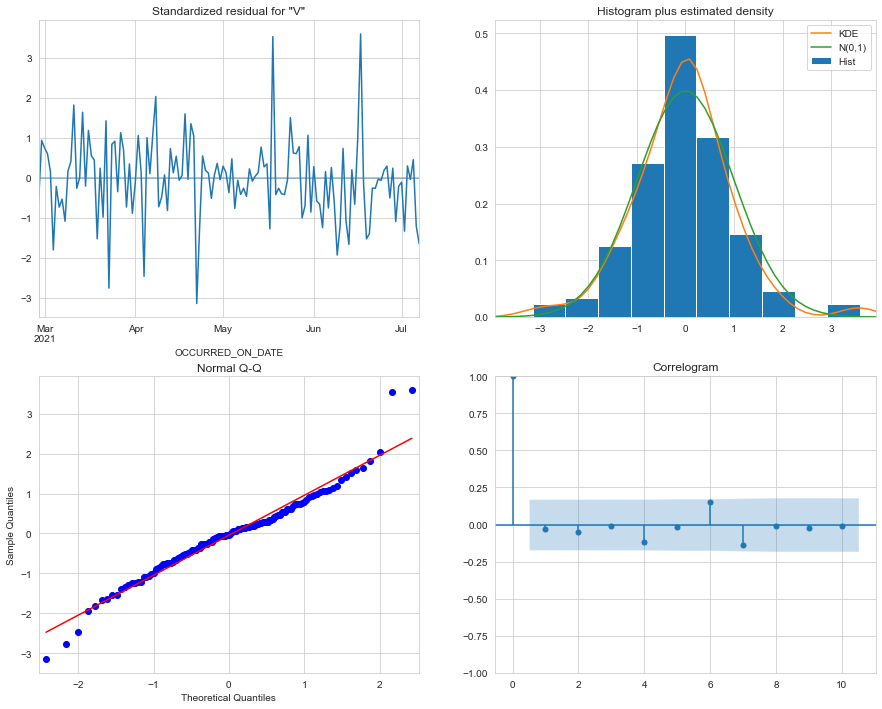

In [27]:
vandalism_model.plot_diagnostics(figsize=(15, 12))
plt.show()

In [28]:
# Final Verbal Dispute Model

# order = (0,1,1)
# seasonal_order = (0,0,1,14)
order = (1,1,3)
seasonal_order = (2,1,0,35)

verbal_model = tsa.statespace.SARIMAX(verbal_log, order = order, seasonal_order = seasonal_order).fit()
verbal_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:                      VERBAL_DISPUTE   No. Observations:                  188
Model:             SARIMAX(1, 1, 3)x(2, 1, [], 35)   Log Likelihood                -159.446
Date:                             Sat, 21 Aug 2021   AIC                            332.891
Time:                                     04:58:53   BIC                            354.058
Sample:                                 01-01-2021   HQIC                           341.490
                                      - 07-07-2021                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9297      0.063    -14.832      0.000      -1.053      -0.807
ma.L1         -0.0344   4.56e+04  -7.56e-07      1.000   -8.93e+04    8.93e+04
ma.L2         -0.9999    4.4e+04  -2.27e-05      1.000   -8.62e+04    8.62e+04
ma.L3          0.0343   1564.693   2.19e-05      1.000   -3066.707    3066.776
ar.S.L35      -0.6417      0.102     -6.281      0.000      -0.842      -0.441
ar.S.L70      -0.2323      0.116     -2.003      0.045      -0.460      -0.005
sigma2         0.4129   1.88e+04   2.19e-05      1.000   -3.69e+04    3.69e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                10.32
Prob(Q):                              0.95   Prob(JB):                         0.01
Heteroskedasticity (H):               1.32   Skew:                            -0.55
Prob(H) (two-sided):                  0.32   Kurtosis:                         3.65
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

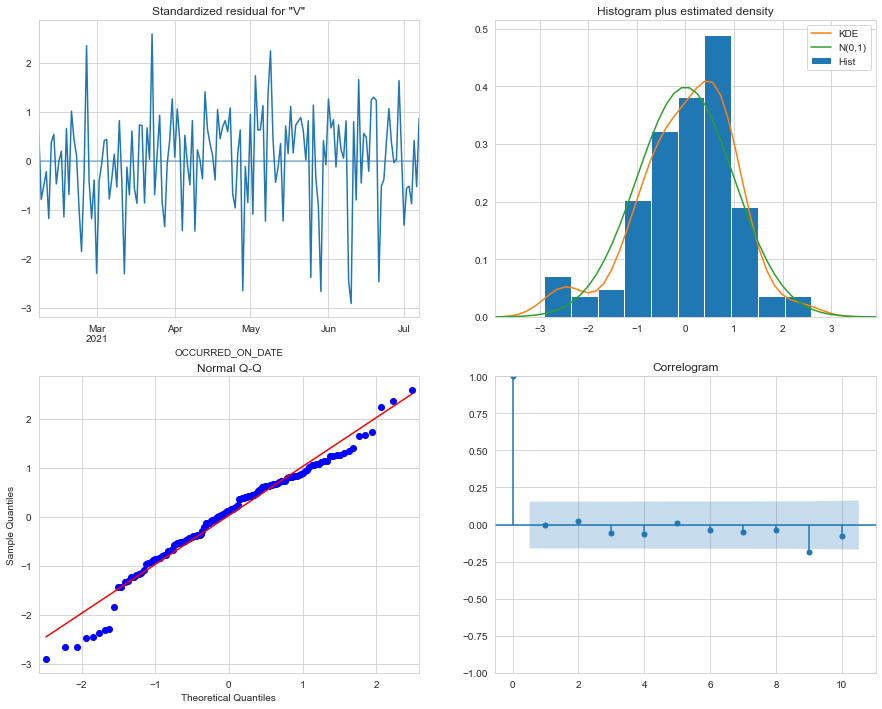

In [29]:
verbal_model.plot_diagnostics(figsize=(15, 12))
plt.show()

## Predictions

In [30]:
#Predictions

vandalism_preds = np.exp(vandalism_model.predict(start = '2021-07-09', end = '2021-12-31', dynamic = True))
verbal_preds = np.exp(verbal_model.predict(start = '2021-07-09', end = '2021-12-31', dynamic = True))

In [31]:
#crime_pred.csv

crime_pred = pd.DataFrame(vandalism_preds)
crime_pred.rename(columns = {'predicted_mean':'VANDALISM'}, inplace = True)
crime_pred['VERBAL DISPUTE']= verbal_preds

#crime_pred.to_csv('crime_pred.csv', index=True)

## Visualization of Predictions
>After some manual tuning the final predictions look reasonable

In [32]:
crime_names = crime_2021_clean.rename(columns = {'VANDALISM':'Vandalism', 'VERBAL_DISPUTE':'Verbal_Dispute'})
preds_wdata = pd.concat([crime_names, crime_pred], axis = 1)
preds_wdata.rename(columns = {'Vandalism':'Vandalism', 'Verbal_Dispute':'Verbal_Dispute',
                              'VANDALISM':'Vandalism_Preds', 'VERBAL DISPUTE':'Verbal_Preds'}, inplace = True)

<AxesSubplot:>

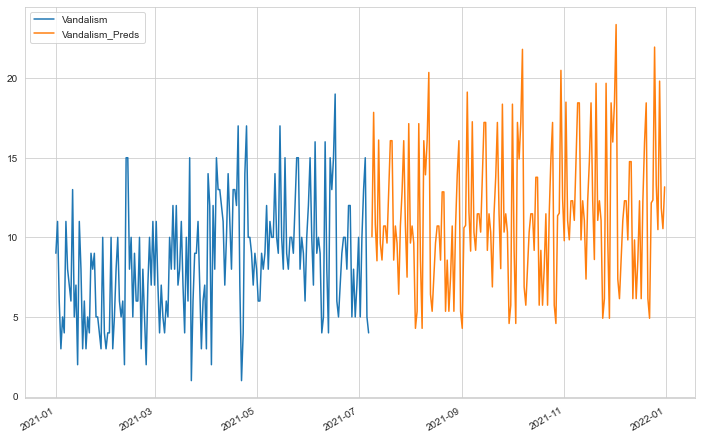

In [33]:
preds_wdata[['Vandalism', 'Vandalism_Preds']].plot(figsize = (12,8))

<AxesSubplot:>

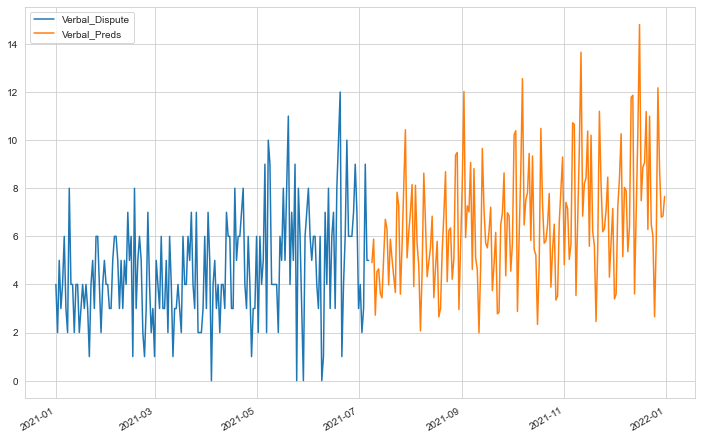

In [34]:
preds_wdata[['Verbal_Dispute', 'Verbal_Preds']].plot(figsize = (12,8))

# Part 2

market1_train.csv contains time series observations for 100 different entities ID0, ID1, ..., ID99. market2_train.csv is similar. You will find that there is some correlation across entities within a market and that the two markets are independent of each other.

For each entity in each market, predict the value of the time series for the next 20 time periods (2021-07-10 through 2021-07-29). Save your predictions for the first dataset in a csv file named market1_pred.csv with the same format as market1_train.csv (and similarly for predictions on the second dataset).

When assessing your submission, we will note the accuracy of your predictions, but mostly we will focus on whether you made an effort to validate your model's performance using a hold-out test set. Be sure to pursue a validation strategy that respects the time series nature of the data.

# Market 1

### Data

In [8]:
market1 = pd.read_csv('data/market1_train.csv', index_col=0)
market1.head()

,ID0,ID1,ID2,ID3,ID4,ID5,ID6,ID7,ID8,ID9,...,ID90,ID91,ID92,ID93,ID94,ID95,ID96,ID97,ID98,ID99
2020-06-05,0.923487,0.636462,0.196549,1.642406,-0.414307,0.116535,1.649359,0.293712,1.709098,1.369384,...,1.290142,1.496324,2.075854,2.306605,2.616544,1.408431,3.086423,1.354975,1.432395,1.079595
2020-06-06,0.896356,0.646727,0.204878,1.686402,-0.461970,0.177137,1.679471,0.315517,1.750805,1.430578,...,1.347296,1.466972,2.111017,2.330013,2.684699,1.394628,3.125490,1.359158,1.453486,1.049957
2020-06-07,0.859538,0.671035,0.217357,1.754765,-0.536844,0.245349,1.705559,0.318119,1.808494,1.459136,...,1.295629,1.488738,2.197938,2.378117,2.680846,1.387548,3.124174,1.394836,1.430801,1.042166
2020-06-08,0.815306,0.693654,0.278475,1.818276,-0.579563,0.237258,1.697547,0.327056,1.834256,1.460969,...,1.238755,1.511074,2.306575,2.413993,2.653495,1.399223,3.135231,1.493550,1.429988,1.021791
2020-06-09,0.829723,0.732132,0.340230,1.804146,-0.566695,0.142860,1.717941,0.342722,1.860003,1.422479,...,1.207137,1.505158,2.387970,2.425192,2.633347,1.443261,3.169891,1.546938,1.434800,1.000036


In [9]:
market1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 400 entries, 2020-06-05 to 2021-07-09
Data columns (total 100 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   ID0     400 non-null    float64
 1   ID1     400 non-null    float64
 2   ID2     400 non-null    float64
 3   ID3     400 non-null    float64
 4   ID4     400 non-null    float64
 5   ID5     400 non-null    float64
 6   ID6     400 non-null    float64
 7   ID7     400 non-null    float64
 8   ID8     400 non-null    float64
 9   ID9     400 non-null    float64
 10  ID10    400 non-null    float64
 11  ID11    400 non-null    float64
 12  ID12    400 non-null    float64
 13  ID13    400 non-null    float64
 14  ID14    400 non-null    float64
 15  ID15    400 non-null    float64
 16  ID16    400 non-null    float64
 17  ID17    400 non-null    float64
 18  ID18    400 non-null    float64
 19  ID19    400 non-null    float64
 20  ID20    400 non-null    float64
 21  ID21    400 non-null    flo

In [10]:
market1.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
ID0,400.0,1.596102,0.942562,0.431381,0.977043,1.188283,2.214234,3.612631
ID1,400.0,1.943122,0.759410,0.420059,1.508807,2.128153,2.443121,3.236072
ID2,400.0,1.364417,0.557662,0.196549,0.910178,1.265792,1.741052,2.552634
ID3,400.0,2.347348,0.314174,1.642406,2.109174,2.359909,2.518241,3.121936
ID4,400.0,0.928827,0.546315,-0.579563,0.554302,1.063903,1.371925,1.758784
...,...,...,...,...,...,...,...,...
ID95,400.0,2.260515,0.320755,1.387548,2.086034,2.238950,2.493609,2.959711
ID96,400.0,1.346591,0.836141,-0.097996,0.501881,1.496993,1.935734,3.169891
ID97,400.0,1.960347,0.500520,0.929021,1.636254,1.942178,2.216110,2.954270
ID98,400.0,2.836240,0.538407,1.262612,2.592002,2.971162,3.177835,3.733810


In [11]:
market1.isnull().values.any()

False

> #### The data looks really clean so minimal preparation will be required

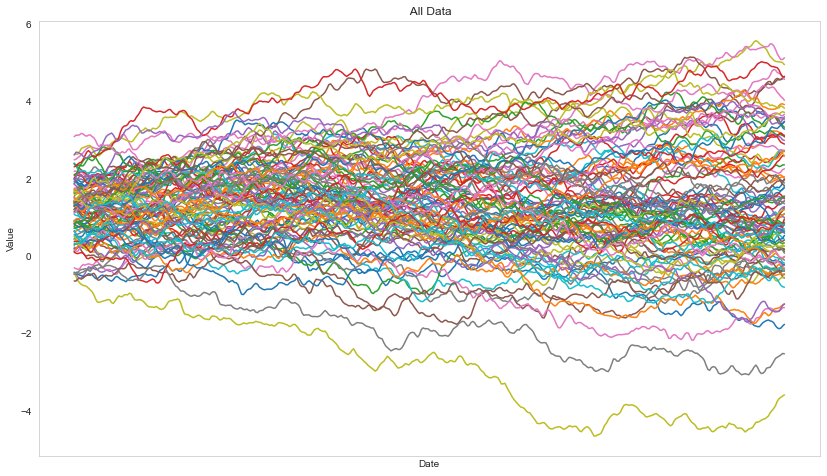

In [33]:
# A quick look at all the data

plt.figure(figsize=(14,8))
plt.plot(market1)
plt.ylabel("Value")
plt.xlabel("Date")
plt.title(" All Data")
plt.xticks([])
plt.grid(False)

## Split Data
>Split the data 75/25 by time

In [13]:
train_df = market1.iloc[:300,:].copy()
val_df =  market1.iloc[300:,: ].copy() 
print(train_df.shape, val_df.shape)                       

(300, 100) (100, 100)


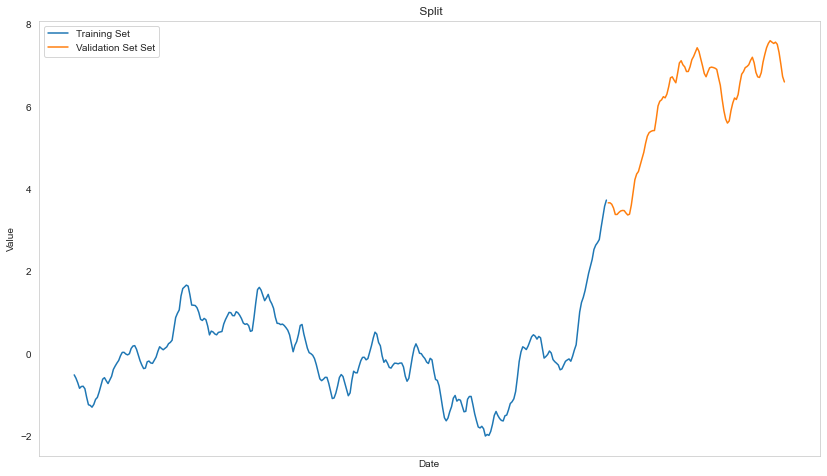

In [32]:
#Train validation split

plt.figure(figsize=(14,8))
plt.plot(train_df['ID0'])
plt.plot(val_df['ID0'])
plt.ylabel("Value")
plt.xlabel("Date")
plt.legend(["Training Set", "Validation Set Set"])
plt.title(" Split")
plt.xticks([])
plt.grid(False)

## Winsorize Data
> I decided not to Winsorize the data because several entities were clipped for the majority of the validation set. This would lead to a lower MSE on the validation, but poor predictions. 

In [15]:
# lower_cutoff = train_df.quantile(0.01)
# upper_cutoff = train_df.quantile(0.99)

# train_df.clip(lower_cutoff, upper_cutoff, axis = 1, inplace = True )
# val_df.clip(lower_cutoff, upper_cutoff, axis = 1, inplace = True )

## Normalize Data
> normalize the training and validation data by the mean and standard deviation of the training data to eliminate data leaks

In [16]:
train_mean = train_df.mean()
train_std = train_df.std()

train_df = (train_df - train_mean) / train_std
val_df = (val_df - train_mean) / train_std

## Reshape Data
> The data will be reshaped into 50 day rolling windows to retain the time-series' properties

In [29]:
sanity_check, train_dict, val_dict, train_shape = tsh.create_time_dict(train_df, val_df, win_len = 50)
sanity_check

,X_train,y_train,X_val,y_val
ID0,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID1,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID2,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID3,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID4,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
...,...,...,...,...
ID95,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID96,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID97,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID98,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"


## Model
>A TensorFlow LSTM model is used. I chose this because it is a classic RNN that generally yields good results 

In [ ]:
train_shape

In [34]:
#define the model

LSTM_rnn = Sequential()
LSTM_rnn.add(LSTM(units=50, return_sequences=True, input_shape=train_shape))
LSTM_rnn.add(Dropout(0.2))
LSTM_rnn.add(LSTM(units=50, return_sequences=True))
LSTM_rnn.add(Dropout(0.2))
LSTM_rnn.add(LSTM(units=50, return_sequences=True))
LSTM_rnn.add(Dropout(0.5))
LSTM_rnn.add(LSTM(units=50))
LSTM_rnn.add(Dropout(0.5))
LSTM_rnn.add(Dense(units=1))

LSTM_rnn.summary()
#tf.keras.utils.plot_model(LSTM_rnn, 'model.png', show_shapes = True)

NameError: name 'X_train' is not defined

In [18]:
#compile the model and iterate through the data for the initial fit

LSTM_rnn.compile(optimizer='rmsprop', loss='mean_squared_error')

# Fit
for ent in entity_list:
    print("Fitting ", ent)
    tf.keras.backend.clear_session()
    gc.collect()
    
    LSTM_rnn.fit(train_dict[ent]["X"], train_dict[ent]["y"], 
                 epochs=10, 
                 batch_size=100)

Fitting  ID0
Epoch 1/10
3/3 [==============================] - 8s 20ms/step - loss: 1.0094
Epoch 2/10
3/3 [==============================] - 0s 18ms/step - loss: 0.7589
Epoch 3/10
3/3 [==============================] - 0s 18ms/step - loss: 0.6784
Epoch 4/10
3/3 [==============================] - 0s 18ms/step - loss: 0.5586
Epoch 5/10
3/3 [==============================] - 0s 20ms/step - loss: 0.5326
Epoch 6/10
3/3 [==============================] - 0s 21ms/step - loss: 0.4667
Epoch 7/10
3/3 [==============================] - 0s 19ms/step - loss: 0.4290
Epoch 8/10
3/3 [==============================] - 0s 18ms/step - loss: 0.4028
Epoch 9/10
3/3 [==============================] - 0s 19ms/step - loss: 0.4644
Epoch 10/10
3/3 [==============================] - 0s 19ms/step - loss: 0.3673
Fitting  ID1
Epoch 1/10
3/3 [==============================] - 1s 17ms/step - loss: 0.1171
Epoch 2/10
3/3 [==============================] - 0s 19ms/step - loss: 0.1303
Epoch 3/10
3/3 [=====================

3/3 [==============================] - 0s 24ms/step - loss: 0.1177
Epoch 5/10
3/3 [==============================] - 0s 20ms/step - loss: 0.1123
Epoch 6/10
3/3 [==============================] - 0s 18ms/step - loss: 0.1120
Epoch 7/10
3/3 [==============================] - 0s 17ms/step - loss: 0.1150
Epoch 8/10
3/3 [==============================] - 0s 18ms/step - loss: 0.1047
Epoch 9/10
3/3 [==============================] - 0s 18ms/step - loss: 0.0999
Epoch 10/10
3/3 [==============================] - 0s 18ms/step - loss: 0.1167
Fitting  ID11
Epoch 1/10
3/3 [==============================] - 1s 18ms/step - loss: 0.0522
Epoch 2/10
3/3 [==============================] - 0s 18ms/step - loss: 0.0570
Epoch 3/10
3/3 [==============================] - 0s 19ms/step - loss: 0.0519
Epoch 4/10
3/3 [==============================] - 0s 19ms/step - loss: 0.0397
Epoch 5/10
3/3 [==============================] - 0s 22ms/step - loss: 0.0425
Epoch 6/10
3/3 [==============================] - 0s 23ms/st

Epoch 10/10
3/3 [==============================] - 0s 22ms/step - loss: 0.0361
Fitting  ID31
Epoch 1/10
3/3 [==============================] - 1s 21ms/step - loss: 0.0207
Epoch 2/10
3/3 [==============================] - 0s 26ms/step - loss: 0.0250
Epoch 3/10
3/3 [==============================] - 0s 21ms/step - loss: 0.0374
Epoch 4/10
3/3 [==============================] - 0s 25ms/step - loss: 0.0263
Epoch 5/10
3/3 [==============================] - 0s 24ms/step - loss: 0.0233
Epoch 6/10
3/3 [==============================] - 0s 29ms/step - loss: 0.0202
Epoch 7/10
3/3 [==============================] - 0s 28ms/step - loss: 0.0208
Epoch 8/10
3/3 [==============================] - 0s 22ms/step - loss: 0.0215
Epoch 9/10
3/3 [==============================] - 0s 26ms/step - loss: 0.0331
Epoch 10/10
3/3 [==============================] - 0s 23ms/step - loss: 0.0217
Fitting  ID32
Epoch 1/10
3/3 [==============================] - 1s 24ms/step - loss: 0.0695
Epoch 2/10
3/3 [==================

3/3 [==============================] - 0s 21ms/step - loss: 0.0422
Epoch 6/10
3/3 [==============================] - 0s 19ms/step - loss: 0.0384
Epoch 7/10
3/3 [==============================] - 0s 21ms/step - loss: 0.0352
Epoch 8/10
3/3 [==============================] - 0s 19ms/step - loss: 0.0396
Epoch 9/10
3/3 [==============================] - 0s 21ms/step - loss: 0.0509
Epoch 10/10
3/3 [==============================] - 0s 20ms/step - loss: 0.0485
Fitting  ID52
Epoch 1/10
3/3 [==============================] - 1s 22ms/step - loss: 0.0378
Epoch 2/10
3/3 [==============================] - 0s 21ms/step - loss: 0.0466
Epoch 3/10
3/3 [==============================] - 0s 21ms/step - loss: 0.0441
Epoch 4/10
3/3 [==============================] - 0s 27ms/step - loss: 0.0244
Epoch 5/10
3/3 [==============================] - 0s 21ms/step - loss: 0.0305
Epoch 6/10
3/3 [==============================] - 0s 20ms/step - loss: 0.0266
Epoch 7/10
3/3 [==============================] - 0s 22ms/st

3/3 [==============================] - 0s 26ms/step - loss: 0.0199
Fitting  ID72
Epoch 1/10
3/3 [==============================] - 1s 24ms/step - loss: 0.0230
Epoch 2/10
3/3 [==============================] - 0s 24ms/step - loss: 0.0417
Epoch 3/10
3/3 [==============================] - 0s 30ms/step - loss: 0.0335
Epoch 4/10
3/3 [==============================] - 0s 23ms/step - loss: 0.0316
Epoch 5/10
3/3 [==============================] - 0s 29ms/step - loss: 0.0202
Epoch 6/10
3/3 [==============================] - 0s 27ms/step - loss: 0.0236
Epoch 7/10
3/3 [==============================] - 0s 24ms/step - loss: 0.0266
Epoch 8/10
3/3 [==============================] - 0s 24ms/step - loss: 0.0228
Epoch 9/10
3/3 [==============================] - 0s 27ms/step - loss: 0.0250
Epoch 10/10
3/3 [==============================] - 0s 25ms/step - loss: 0.0311
Fitting  ID73
Epoch 1/10
3/3 [==============================] - 1s 27ms/step - loss: 0.0155
Epoch 2/10
3/3 [==============================

3/3 [==============================] - 0s 22ms/step - loss: 0.0349
Epoch 4/10
3/3 [==============================] - 0s 20ms/step - loss: 0.0243
Epoch 5/10
3/3 [==============================] - 0s 22ms/step - loss: 0.0242
Epoch 6/10
3/3 [==============================] - 0s 20ms/step - loss: 0.0226
Epoch 7/10
3/3 [==============================] - 0s 20ms/step - loss: 0.0266
Epoch 8/10
3/3 [==============================] - 0s 20ms/step - loss: 0.0278
Epoch 9/10
3/3 [==============================] - 0s 20ms/step - loss: 0.0282
Epoch 10/10
3/3 [==============================] - 0s 26ms/step - loss: 0.0228
Fitting  ID83
Epoch 1/10
3/3 [==============================] - 1s 19ms/step - loss: 0.0247
Epoch 2/10
3/3 [==============================] - 0s 21ms/step - loss: 0.0261
Epoch 3/10
3/3 [==============================] - 0s 21ms/step - loss: 0.0248
Epoch 4/10
3/3 [==============================] - 0s 24ms/step - loss: 0.0209
Epoch 5/10
3/3 [==============================] - 0s 19ms/st

### Validation
>make predictions on the validation data and graph the predictions 
>
> The individual predictions can be seen by scrolling through the sidebar

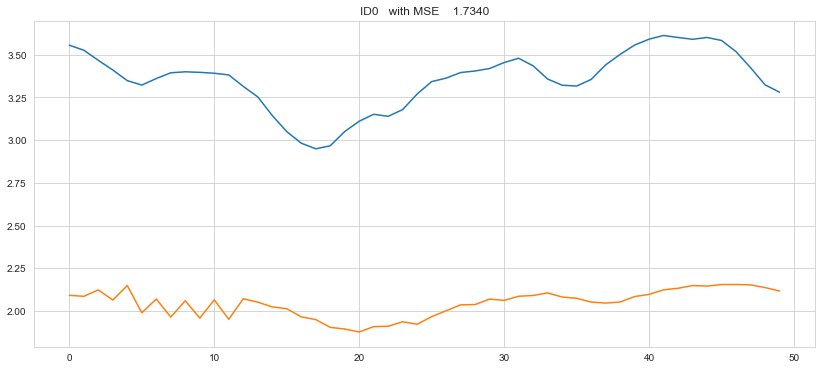

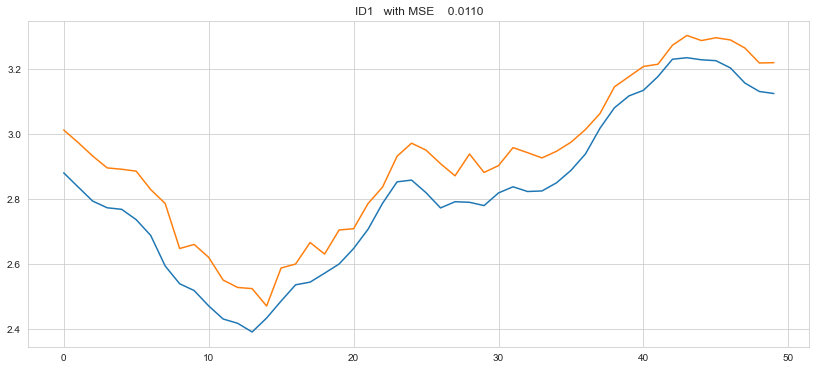

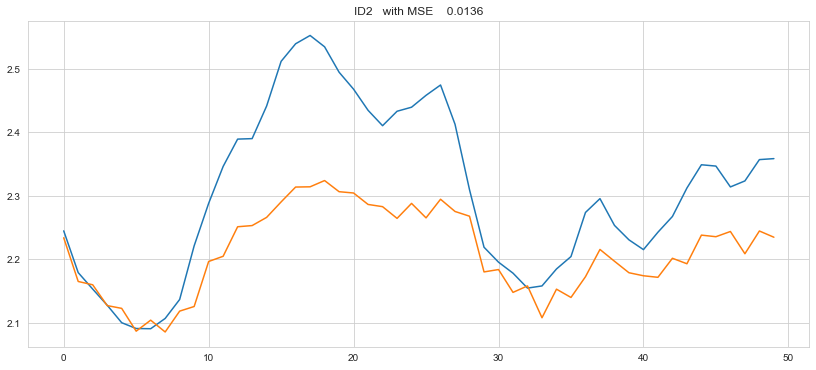

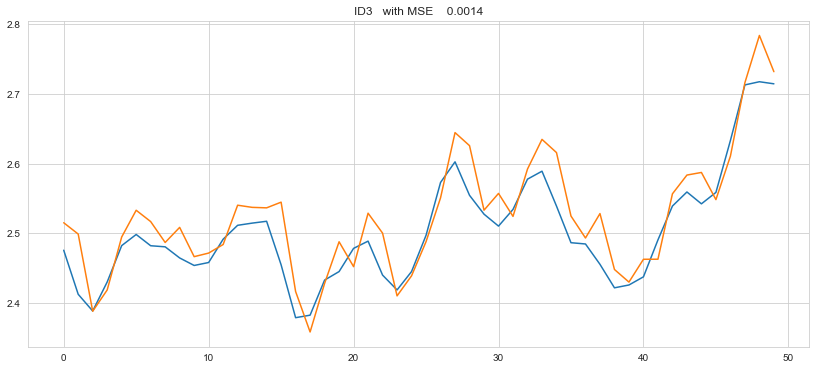

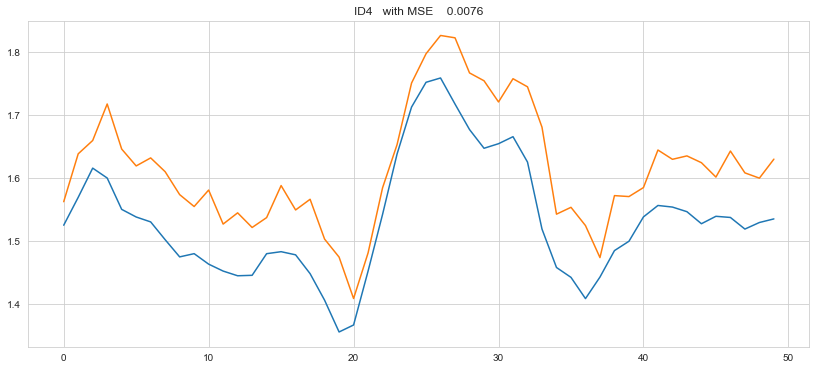

...

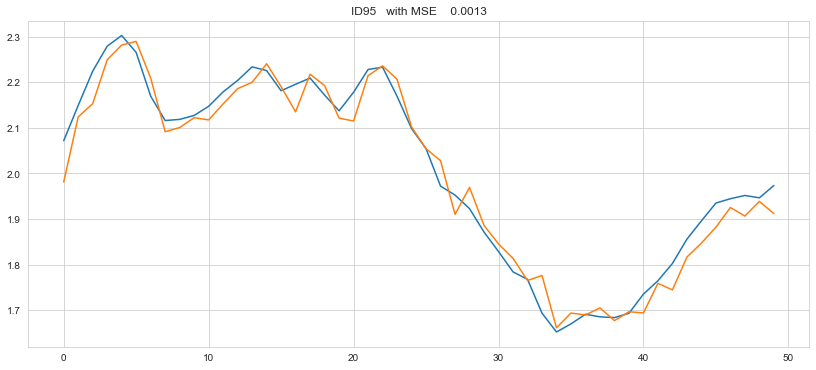

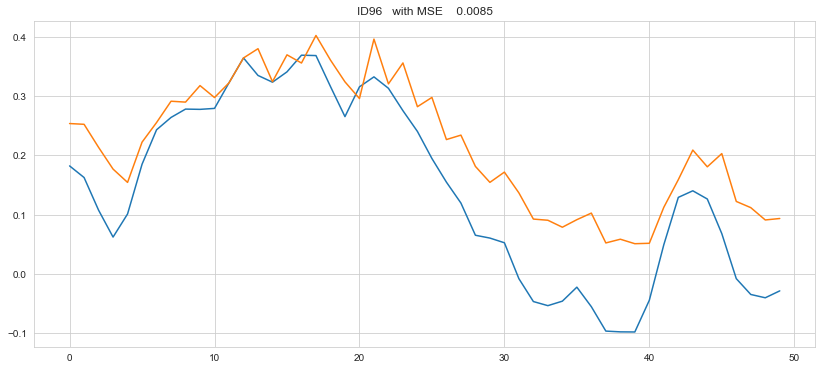

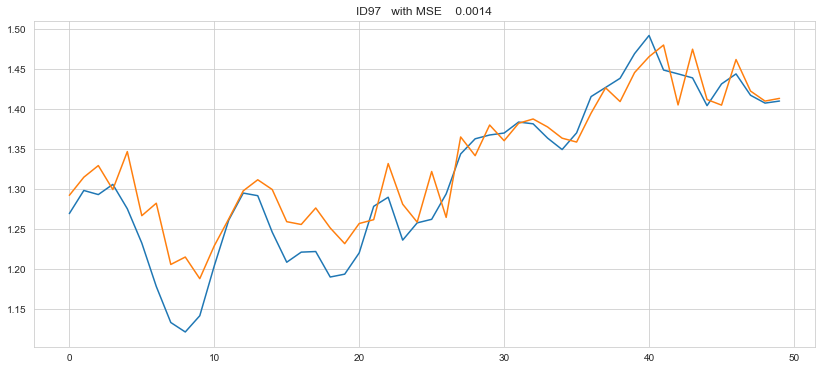

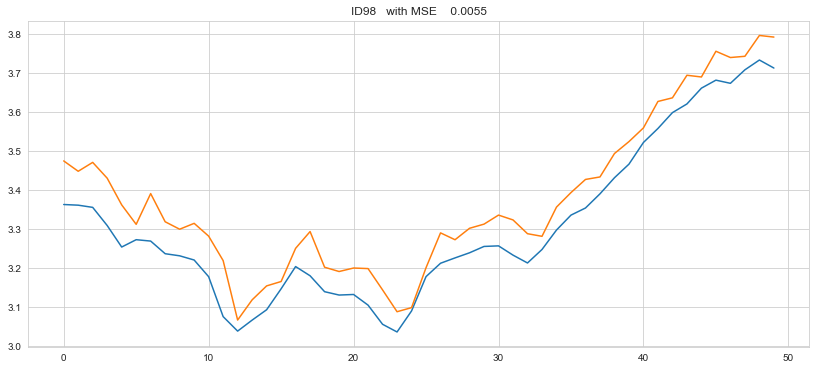

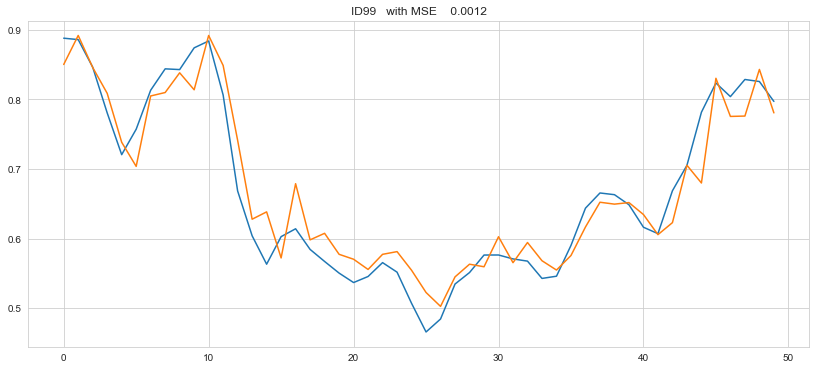

In [19]:
pred_result = {}
overall_MSE = []

for ent in entity_list:
    y_true = ((val_dict[ent]["y"].reshape(-1,1)) * train_std[ent]) + train_mean[ent]
    
    #Predict
    y_pred = ((LSTM_rnn.predict(val_dict[ent]["X"])) * train_std[ent]) + train_mean[ent]
    
    MSE = mean_squared_error(y_true, y_pred)
    plt.figure(figsize=(14,6))
    plt.title("{}   with MSE{:10.4f}".format(ent,MSE))
    plt.plot(y_true)
    plt.plot(y_pred)
    
    overall_MSE.append(MSE)
    pred_result[ent] = {}
    pred_result[ent]['MSE']  = MSE
    pred_result[ent]["True"] = y_true
    pred_result[ent]["Pred"] = y_pred       

### The Overall MSE for all entities combined

In [20]:
print('Min MSE:    {0:.4f}\nMax MSE:    {1:.4f}\nMedian MSE: {2:.4f}\nMean MSE:   {3:.4f}'.format(np.min(overall_MSE), 
                                                                                                  np.max(overall_MSE), 
                                                                                                  np.median(overall_MSE), 
                                                                                                  np.mean(overall_MSE)))

Min MSE:    0.0008
Max MSE:    1.7340
Median MSE: 0.0035
Mean MSE:   0.0894


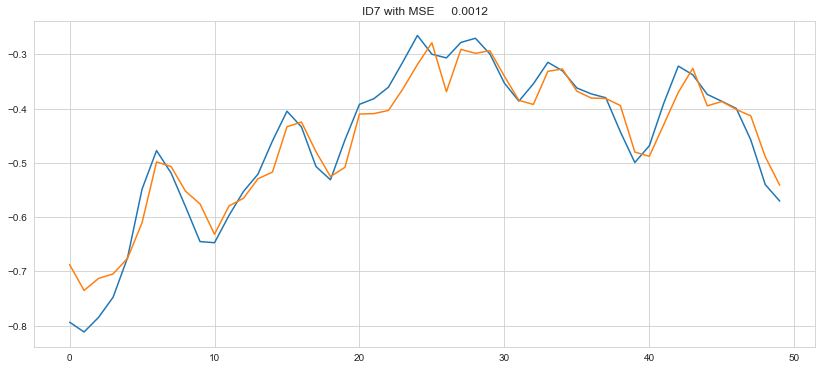

In [21]:
#View of individual entities

ent = 'ID7'

plt.figure(figsize=(14,6))
plt.title("{} with MSE {:10.4f}".format(ent,MSE))
plt.plot(pred_result[ent]["True"])
plt.plot(pred_result[ent]["Pred"])

## Final Model
>The final model trained on all data

### Final Data

In [17]:
#Normalize

train_full_df = market1.copy()
full_mean = train_full_df.mean()
full_std = train_full_df.std()

train_full_df = (train_full_df - full_mean) / full_std
train_full_df.shape

(400, 100)

In [18]:
#Reshape

entity_list = train_full_df.columns
train_full_temp = {}


for ent in entity_list:
    train_full_temp[ent] = np.array(train_full_df[ent]).reshape(train_full_df.shape[0],1)
    
print(train_full_temp['ID0'].shape)

(400, 1)


In [19]:
train_full_dict = {}

for ent in entity_list:
    train_full_dict[ent] = {}
    X_train = []
    y_train = []
    
    win_len = 50 
    
    for i in range(win_len, 400):
        X_train.append(train_full_temp[ent][i-win_len:i,0])
        y_train.append(train_full_temp[ent][i,0])
        
    X_train, y_train = np.array(X_train), np.array(y_train)
    train_full_dict[ent]["X"] = np.reshape(X_train, (X_train.shape[0],X_train.shape[1],1))
    train_full_dict[ent]["y"] = y_train

## Final Model

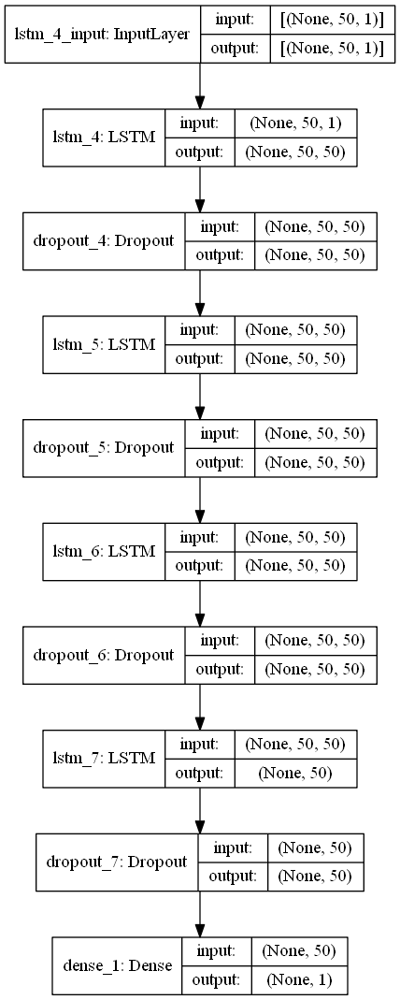

In [20]:
LSTM_rnn = Sequential()
LSTM_rnn.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1],1)))
LSTM_rnn.add(Dropout(0.2))
LSTM_rnn.add(LSTM(units=50, return_sequences=True))
LSTM_rnn.add(Dropout(0.2))
LSTM_rnn.add(LSTM(units=50, return_sequences=True))
LSTM_rnn.add(Dropout(0.5))
LSTM_rnn.add(LSTM(units=50))
LSTM_rnn.add(Dropout(0.5))
LSTM_rnn.add(Dense(units=1))

#LSTM_rnn.summary()
tf.keras.utils.plot_model(LSTM_rnn, 'model.png', show_shapes = True)

## Initial Fit

In [21]:
LSTM_rnn.compile(optimizer='rmsprop', loss='mean_squared_error')


for ent in entity_list:
    print("Fitting ", ent)
    tf.keras.backend.clear_session()
    gc.collect()
    
    LSTM_rnn.fit(train_full_dict[ent]["X"], train_full_dict[ent]["y"], 
                 epochs=10, 
                 batch_size=100)

Fitting  ID0
Epoch 1/10
4/4 [==============================] - 8s 20ms/step - loss: 0.6430
Epoch 2/10
4/4 [==============================] - 0s 22ms/step - loss: 0.1624
Epoch 3/10
4/4 [==============================] - 0s 18ms/step - loss: 0.1527
Epoch 4/10
4/4 [==============================] - 0s 19ms/step - loss: 0.1242
Epoch 5/10
4/4 [==============================] - 0s 22ms/step - loss: 0.1337
Epoch 6/10
4/4 [==============================] - 0s 21ms/step - loss: 0.1383
Epoch 7/10
4/4 [==============================] - 0s 22ms/step - loss: 0.1102
Epoch 8/10
4/4 [==============================] - 0s 21ms/step - loss: 0.1141
Epoch 9/10
4/4 [==============================] - 0s 21ms/step - loss: 0.1074
Epoch 10/10
4/4 [==============================] - 0s 20ms/step - loss: 0.1291
Fitting  ID1
Epoch 1/10
4/4 [==============================] - 1s 24ms/step - loss: 0.2553
Epoch 2/10
4/4 [==============================] - 0s 21ms/step - loss: 0.1276
Epoch 3/10
4/4 [=====================

4/4 [==============================] - 0s 24ms/step - loss: 0.0672
Epoch 5/10
4/4 [==============================] - 0s 26ms/step - loss: 0.0665
Epoch 6/10
4/4 [==============================] - 0s 22ms/step - loss: 0.0658
Epoch 7/10
4/4 [==============================] - 0s 24ms/step - loss: 0.0698
Epoch 8/10
4/4 [==============================] - 0s 24ms/step - loss: 0.0765
Epoch 9/10
4/4 [==============================] - 0s 24ms/step - loss: 0.0730
Epoch 10/10
4/4 [==============================] - 0s 28ms/step - loss: 0.0626
Fitting  ID11
Epoch 1/10
4/4 [==============================] - 1s 25ms/step - loss: 0.0628
Epoch 2/10
4/4 [==============================] - 0s 26ms/step - loss: 0.0508
Epoch 3/10
4/4 [==============================] - 0s 26ms/step - loss: 0.0563
Epoch 4/10
4/4 [==============================] - 0s 24ms/step - loss: 0.0426
Epoch 5/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0464
Epoch 6/10
4/4 [==============================] - 0s 23ms/st

Epoch 7/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0640
Epoch 8/10
4/4 [==============================] - 0s 24ms/step - loss: 0.0492
Epoch 9/10
4/4 [==============================] - 0s 22ms/step - loss: 0.0627
Epoch 10/10
4/4 [==============================] - 0s 24ms/step - loss: 0.0499
Fitting  ID21
Epoch 1/10
4/4 [==============================] - 1s 24ms/step - loss: 0.0518
Epoch 2/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0599
Epoch 3/10
4/4 [==============================] - 0s 25ms/step - loss: 0.0467
Epoch 4/10
4/4 [==============================] - 0s 28ms/step - loss: 0.0418
Epoch 5/10
4/4 [==============================] - 0s 22ms/step - loss: 0.0420
Epoch 6/10
4/4 [==============================] - 0s 22ms/step - loss: 0.0397
Epoch 7/10
4/4 [==============================] - 0s 24ms/step - loss: 0.0417
Epoch 8/10
4/4 [==============================] - 0s 24ms/step - loss: 0.0406
Epoch 9/10
4/4 [==============================] -

4/4 [==============================] - 0s 22ms/step - loss: 0.0331
Fitting  ID31
Epoch 1/10
4/4 [==============================] - 1s 23ms/step - loss: 0.0280
Epoch 2/10
4/4 [==============================] - 0s 22ms/step - loss: 0.0264
Epoch 3/10
4/4 [==============================] - 0s 22ms/step - loss: 0.0312
Epoch 4/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0258
Epoch 5/10
4/4 [==============================] - 0s 26ms/step - loss: 0.0195
Epoch 6/10
4/4 [==============================] - 0s 26ms/step - loss: 0.0299
Epoch 7/10
4/4 [==============================] - 0s 25ms/step - loss: 0.0228
Epoch 8/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0203
Epoch 9/10
4/4 [==============================] - 0s 26ms/step - loss: 0.0242
Epoch 10/10
4/4 [==============================] - 0s 28ms/step - loss: 0.0210
Fitting  ID32
Epoch 1/10
4/4 [==============================] - 1s 27ms/step - loss: 0.0546
Epoch 2/10
4/4 [==============================

4/4 [==============================] - 0s 22ms/step - loss: 0.0308
Epoch 4/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0316
Epoch 5/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0294
Epoch 6/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0395
Epoch 7/10
4/4 [==============================] - 0s 22ms/step - loss: 0.0355
Epoch 8/10
4/4 [==============================] - 0s 21ms/step - loss: 0.0289
Epoch 9/10
4/4 [==============================] - 0s 21ms/step - loss: 0.0353
Epoch 10/10
4/4 [==============================] - 0s 22ms/step - loss: 0.0388
Fitting  ID42
Epoch 1/10
4/4 [==============================] - 1s 24ms/step - loss: 0.0508
Epoch 2/10
4/4 [==============================] - 0s 22ms/step - loss: 0.0412
Epoch 3/10
4/4 [==============================] - 0s 21ms/step - loss: 0.0434
Epoch 4/10
4/4 [==============================] - 0s 21ms/step - loss: 0.0356
Epoch 5/10
4/4 [==============================] - 0s 22ms/st

4/4 [==============================] - 0s 23ms/step - loss: 0.0482
Epoch 10/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0456
Fitting  ID62
Epoch 1/10
4/4 [==============================] - 1s 26ms/step - loss: 0.0315
Epoch 2/10
4/4 [==============================] - 0s 24ms/step - loss: 0.0319
Epoch 3/10
4/4 [==============================] - 0s 21ms/step - loss: 0.0283
Epoch 4/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0248
Epoch 5/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0267
Epoch 6/10
4/4 [==============================] - 0s 24ms/step - loss: 0.0314
Epoch 7/10
4/4 [==============================] - 0s 24ms/step - loss: 0.0300
Epoch 8/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0308
Epoch 9/10
4/4 [==============================] - 0s 27ms/step - loss: 0.0315
Epoch 10/10
4/4 [==============================] - 0s 23ms/step - loss: 0.0315
Fitting  ID63
Epoch 1/10
4/4 [=============================

Epoch 4/10
4/4 [==============================] - 0s 113ms/step - loss: 0.0338
Epoch 5/10
4/4 [==============================] - 0s 119ms/step - loss: 0.0261
Epoch 6/10
4/4 [==============================] - 0s 120ms/step - loss: 0.0267
Epoch 7/10
4/4 [==============================] - 0s 118ms/step - loss: 0.0287
Epoch 8/10
4/4 [==============================] - 1s 123ms/step - loss: 0.0294
Epoch 9/10
4/4 [==============================] - 2s 488ms/step - loss: 0.0287
Epoch 10/10
4/4 [==============================] - 1s 198ms/step - loss: 0.0295
Fitting  ID83
Epoch 1/10
4/4 [==============================] - 1s 119ms/step - loss: 0.0299
Epoch 2/10
4/4 [==============================] - 1s 265ms/step - loss: 0.0207
Epoch 3/10
4/4 [==============================] - 1s 332ms/step - loss: 0.0189
Epoch 4/10
4/4 [==============================] - 2s 308ms/step - loss: 0.0212
Epoch 5/10
4/4 [==============================] - 1s 318ms/step - loss: 0.0182
Epoch 6/10
4/4 [=====================

## Autoregressive Final Predictions
>The final predictions were made using a rolling 50 period window making one prediction at a time. The prediction is added to the data to make the next prediction.

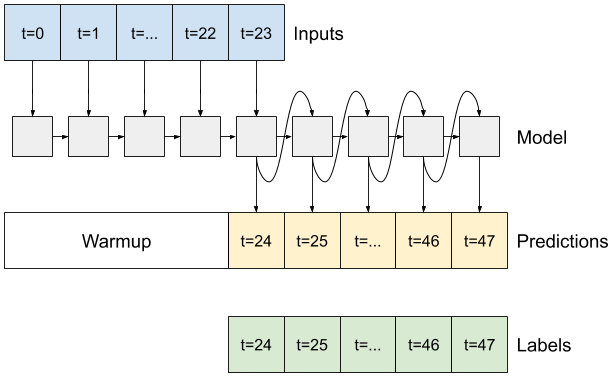

In [22]:
n_forecast = 20  #20
rng = pd.date_range('2021-07-10', periods=n_forecast, freq='D').astype(str)
pred_df = pd.DataFrame(columns = entity_list, index=rng)

forecast_X = {}
forecast_y = {}

for ent in entity_list:    
    x = train_full_dict[ent]['X'][349][1:].reshape(-1, 49, 1)
    forecast_X[ent] = x
    forecast_y[ent] = train_full_dict[ent]['y'][-50:].reshape( 50, 1)

    
for ent in entity_list:
    for i in range(n_forecast):     
        
        if(i == 0):
            print('Initializing x,y')
            y = forecast_y[ent][-1]
            x = forecast_X[ent][0:]
            X = np.append(x, y).reshape(-1,50,1)
        print('Predicting {}  forecast period {} '.format( ent, i+1))
        
        y_pred = (LSTM_rnn.predict(X)) 

#         LSTM_rnn.fit(X, y_new, 
#                   epochs=1,    
#                   batch_size=50,
#                   #callbacks = [clr_triangular]
#                  ) 
        
        y_new = y_pred[0][:].reshape(-1,1)
        X = np.append(X[0][1:], y_new).reshape(-1,50,1)    
    
    #write to df
    print('Writing to df')
    pred_df[ent] = X[0][-n_forecast:]      

Initializing x,y
Predicting ID0  forecast period 1 
Predicting ID0  forecast period 2 
Predicting ID0  forecast period 3 
Predicting ID0  forecast period 4 
Predicting ID0  forecast period 5 
Predicting ID0  forecast period 6 
Predicting ID0  forecast period 7 
Predicting ID0  forecast period 8 
Predicting ID0  forecast period 9 
Predicting ID0  forecast period 10 
Predicting ID0  forecast period 11 
Predicting ID0  forecast period 12 
Predicting ID0  forecast period 13 
Predicting ID0  forecast period 14 
Predicting ID0  forecast period 15 
Predicting ID0  forecast period 16 
Predicting ID0  forecast period 17 
Predicting ID0  forecast period 18 
Predicting ID0  forecast period 19 
Predicting ID0  forecast period 20 
Writing to df
Initializing x,y
Predicting ID1  forecast period 1 
Predicting ID1  forecast period 2 
Predicting ID1  forecast period 3 
Predicting ID1  forecast period 4 
Predicting ID1  forecast period 5 
Predicting ID1  forecast period 6 
Predicting ID1  forecast period

Predicting ID11  forecast period 3 
Predicting ID11  forecast period 4 
Predicting ID11  forecast period 5 
Predicting ID11  forecast period 6 
Predicting ID11  forecast period 7 
Predicting ID11  forecast period 8 
Predicting ID11  forecast period 9 
Predicting ID11  forecast period 10 
Predicting ID11  forecast period 11 
Predicting ID11  forecast period 12 
Predicting ID11  forecast period 13 
Predicting ID11  forecast period 14 
Predicting ID11  forecast period 15 
Predicting ID11  forecast period 16 
Predicting ID11  forecast period 17 
Predicting ID11  forecast period 18 
Predicting ID11  forecast period 19 
Predicting ID11  forecast period 20 
Writing to df
Initializing x,y
Predicting ID12  forecast period 1 
Predicting ID12  forecast period 2 
Predicting ID12  forecast period 3 
Predicting ID12  forecast period 4 
Predicting ID12  forecast period 5 
Predicting ID12  forecast period 6 
Predicting ID12  forecast period 7 
Predicting ID12  forecast period 8 
Predicting ID12  forec

Predicting ID21  forecast period 19 
Predicting ID21  forecast period 20 
Writing to df
Initializing x,y
Predicting ID22  forecast period 1 
Predicting ID22  forecast period 2 
Predicting ID22  forecast period 3 
Predicting ID22  forecast period 4 
Predicting ID22  forecast period 5 
Predicting ID22  forecast period 6 
Predicting ID22  forecast period 7 
Predicting ID22  forecast period 8 
Predicting ID22  forecast period 9 
Predicting ID22  forecast period 10 
Predicting ID22  forecast period 11 
Predicting ID22  forecast period 12 
Predicting ID22  forecast period 13 
Predicting ID22  forecast period 14 
Predicting ID22  forecast period 15 
Predicting ID22  forecast period 16 
Predicting ID22  forecast period 17 
Predicting ID22  forecast period 18 
Predicting ID22  forecast period 19 
Predicting ID22  forecast period 20 
Writing to df
Initializing x,y
Predicting ID23  forecast period 1 
Predicting ID23  forecast period 2 
Predicting ID23  forecast period 3 
Predicting ID23  forecast

Predicting ID32  forecast period 15 
Predicting ID32  forecast period 16 
Predicting ID32  forecast period 17 
Predicting ID32  forecast period 18 
Predicting ID32  forecast period 19 
Predicting ID32  forecast period 20 
Writing to df
Initializing x,y
Predicting ID33  forecast period 1 
Predicting ID33  forecast period 2 
Predicting ID33  forecast period 3 
Predicting ID33  forecast period 4 
Predicting ID33  forecast period 5 
Predicting ID33  forecast period 6 
Predicting ID33  forecast period 7 
Predicting ID33  forecast period 8 
Predicting ID33  forecast period 9 
Predicting ID33  forecast period 10 
Predicting ID33  forecast period 11 
Predicting ID33  forecast period 12 
Predicting ID33  forecast period 13 
Predicting ID33  forecast period 14 
Predicting ID33  forecast period 15 
Predicting ID33  forecast period 16 
Predicting ID33  forecast period 17 
Predicting ID33  forecast period 18 
Predicting ID33  forecast period 19 
Predicting ID33  forecast period 20 
Writing to df
In

Predicting ID43  forecast period 12 
Predicting ID43  forecast period 13 
Predicting ID43  forecast period 14 
Predicting ID43  forecast period 15 
Predicting ID43  forecast period 16 
Predicting ID43  forecast period 17 
Predicting ID43  forecast period 18 
Predicting ID43  forecast period 19 
Predicting ID43  forecast period 20 
Writing to df
Initializing x,y
Predicting ID44  forecast period 1 
Predicting ID44  forecast period 2 
Predicting ID44  forecast period 3 
Predicting ID44  forecast period 4 
Predicting ID44  forecast period 5 
Predicting ID44  forecast period 6 
Predicting ID44  forecast period 7 
Predicting ID44  forecast period 8 
Predicting ID44  forecast period 9 
Predicting ID44  forecast period 10 
Predicting ID44  forecast period 11 
Predicting ID44  forecast period 12 
Predicting ID44  forecast period 13 
Predicting ID44  forecast period 14 
Predicting ID44  forecast period 15 
Predicting ID44  forecast period 16 
Predicting ID44  forecast period 17 
Predicting ID44 

Predicting ID54  forecast period 9 
Predicting ID54  forecast period 10 
Predicting ID54  forecast period 11 
Predicting ID54  forecast period 12 
Predicting ID54  forecast period 13 
Predicting ID54  forecast period 14 
Predicting ID54  forecast period 15 
Predicting ID54  forecast period 16 
Predicting ID54  forecast period 17 
Predicting ID54  forecast period 18 
Predicting ID54  forecast period 19 
Predicting ID54  forecast period 20 
Writing to df
Initializing x,y
Predicting ID55  forecast period 1 
Predicting ID55  forecast period 2 
Predicting ID55  forecast period 3 
Predicting ID55  forecast period 4 
Predicting ID55  forecast period 5 
Predicting ID55  forecast period 6 
Predicting ID55  forecast period 7 
Predicting ID55  forecast period 8 
Predicting ID55  forecast period 9 
Predicting ID55  forecast period 10 
Predicting ID55  forecast period 11 
Predicting ID55  forecast period 12 
Predicting ID55  forecast period 13 
Predicting ID55  forecast period 14 
Predicting ID55  

Predicting ID65  forecast period 5 
Predicting ID65  forecast period 6 
Predicting ID65  forecast period 7 
Predicting ID65  forecast period 8 
Predicting ID65  forecast period 9 
Predicting ID65  forecast period 10 
Predicting ID65  forecast period 11 
Predicting ID65  forecast period 12 
Predicting ID65  forecast period 13 
Predicting ID65  forecast period 14 
Predicting ID65  forecast period 15 
Predicting ID65  forecast period 16 
Predicting ID65  forecast period 17 
Predicting ID65  forecast period 18 
Predicting ID65  forecast period 19 
Predicting ID65  forecast period 20 
Writing to df
Initializing x,y
Predicting ID66  forecast period 1 
Predicting ID66  forecast period 2 
Predicting ID66  forecast period 3 
Predicting ID66  forecast period 4 
Predicting ID66  forecast period 5 
Predicting ID66  forecast period 6 
Predicting ID66  forecast period 7 
Predicting ID66  forecast period 8 
Predicting ID66  forecast period 9 
Predicting ID66  forecast period 10 
Predicting ID66  fore

Predicting ID76  forecast period 2 
Predicting ID76  forecast period 3 
Predicting ID76  forecast period 4 
Predicting ID76  forecast period 5 
Predicting ID76  forecast period 6 
Predicting ID76  forecast period 7 
Predicting ID76  forecast period 8 
Predicting ID76  forecast period 9 
Predicting ID76  forecast period 10 
Predicting ID76  forecast period 11 
Predicting ID76  forecast period 12 
Predicting ID76  forecast period 13 
Predicting ID76  forecast period 14 
Predicting ID76  forecast period 15 
Predicting ID76  forecast period 16 
Predicting ID76  forecast period 17 
Predicting ID76  forecast period 18 
Predicting ID76  forecast period 19 
Predicting ID76  forecast period 20 
Writing to df
Initializing x,y
Predicting ID77  forecast period 1 
Predicting ID77  forecast period 2 
Predicting ID77  forecast period 3 
Predicting ID77  forecast period 4 
Predicting ID77  forecast period 5 
Predicting ID77  forecast period 6 
Predicting ID77  forecast period 7 
Predicting ID77  forec

Predicting ID86  forecast period 18 
Predicting ID86  forecast period 19 
Predicting ID86  forecast period 20 
Writing to df
Initializing x,y
Predicting ID87  forecast period 1 
Predicting ID87  forecast period 2 
Predicting ID87  forecast period 3 
Predicting ID87  forecast period 4 
Predicting ID87  forecast period 5 
Predicting ID87  forecast period 6 
Predicting ID87  forecast period 7 
Predicting ID87  forecast period 8 
Predicting ID87  forecast period 9 
Predicting ID87  forecast period 10 
Predicting ID87  forecast period 11 
Predicting ID87  forecast period 12 
Predicting ID87  forecast period 13 
Predicting ID87  forecast period 14 
Predicting ID87  forecast period 15 
Predicting ID87  forecast period 16 
Predicting ID87  forecast period 17 
Predicting ID87  forecast period 18 
Predicting ID87  forecast period 19 
Predicting ID87  forecast period 20 
Writing to df
Initializing x,y
Predicting ID88  forecast period 1 
Predicting ID88  forecast period 2 
Predicting ID88  forecas

Predicting ID97  forecast period 14 
Predicting ID97  forecast period 15 
Predicting ID97  forecast period 16 
Predicting ID97  forecast period 17 
Predicting ID97  forecast period 18 
Predicting ID97  forecast period 19 
Predicting ID97  forecast period 20 
Writing to df
Initializing x,y
Predicting ID98  forecast period 1 
Predicting ID98  forecast period 2 
Predicting ID98  forecast period 3 
Predicting ID98  forecast period 4 
Predicting ID98  forecast period 5 
Predicting ID98  forecast period 6 
Predicting ID98  forecast period 7 
Predicting ID98  forecast period 8 
Predicting ID98  forecast period 9 
Predicting ID98  forecast period 10 
Predicting ID98  forecast period 11 
Predicting ID98  forecast period 12 
Predicting ID98  forecast period 13 
Predicting ID98  forecast period 14 
Predicting ID98  forecast period 15 
Predicting ID98  forecast period 16 
Predicting ID98  forecast period 17 
Predicting ID98  forecast period 18 
Predicting ID98  forecast period 19 
Predicting ID98 

In [23]:
pred_df.head()

,ID0,ID1,ID2,ID3,ID4,ID5,ID6,ID7,ID8,ID9,...,ID90,ID91,ID92,ID93,ID94,ID95,ID96,ID97,ID98,ID99
2021-07-10,1.900810,1.665022,1.865723,1.247641,1.180177,1.979324,0.857453,-1.312750,1.599486,-1.275694,...,2.573217,1.973385,-0.253518,1.157515,1.097742,-0.871075,-1.654764,-1.169488,1.697529,-1.041563
2021-07-11,2.068221,1.842511,2.013388,1.367255,1.323143,2.112895,0.901410,-1.394686,1.763186,-1.393990,...,2.497365,2.082817,-0.399105,1.320383,1.167284,-0.982827,-1.696246,-1.297952,1.861646,-1.198543
2021-07-12,2.184931,1.994511,2.134910,1.508049,1.484964,2.211470,0.969254,-1.479964,1.917949,-1.522281,...,2.468344,2.182949,-0.576225,1.480886,1.226562,-1.142169,-1.733328,-1.424116,2.013632,-1.336658
2021-07-13,2.254212,2.105692,2.221037,1.656801,1.640610,2.277573,1.055182,-1.551179,2.039729,-1.610489,...,2.461555,2.260143,-0.754529,1.624285,1.306566,-1.285583,-1.756095,-1.521051,2.128813,-1.438018
2021-07-14,2.297978,2.185743,2.281173,1.802521,1.781726,2.323721,1.157666,-1.606812,2.133006,-1.661180,...,2.458980,2.316059,-0.914223,1.751706,1.414456,-1.393652,-1.769378,-1.588480,2.211227,-1.507583


In [24]:
market1_pred = (pred_df * full_std) + full_mean
train_full_df = (train_full_df * full_std) + full_mean

In [34]:
#market1_pred.to_csv('market1_pred.csv', index=True)

Text(0.5, 1.0, ' Predictions and Original Data')

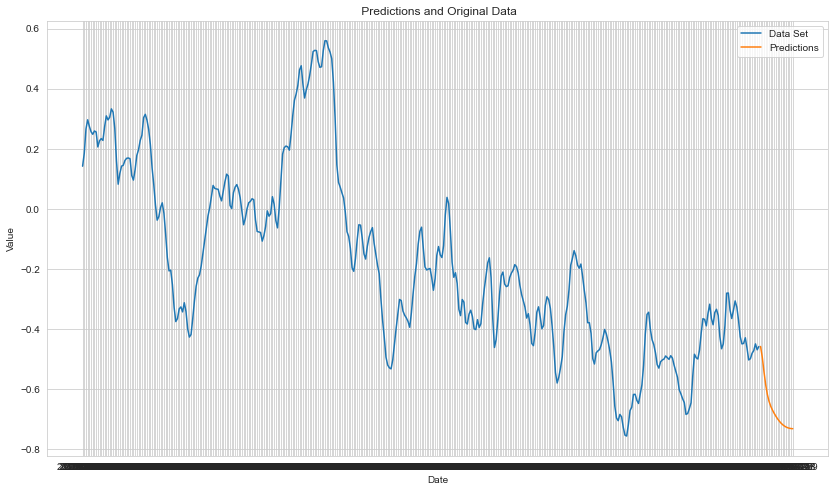

In [35]:
ID = 'ID51'

plt.figure(figsize=(14,8))
plt.plot(train_full_df[ID])
plt.plot(market1_pred[ID])
plt.ylabel("Value")
plt.xlabel("Date")
plt.legend(["Data Set", "Predictions"])
plt.title(" Predictions and Original Data")

## Graphs of all Predictions

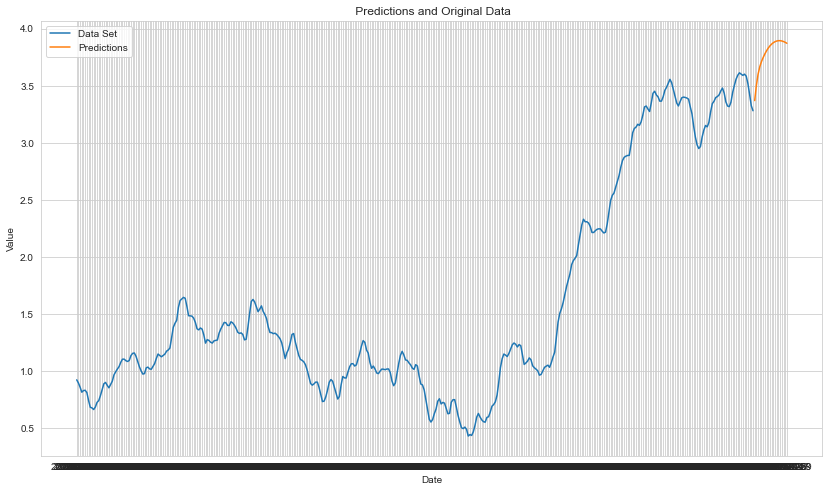

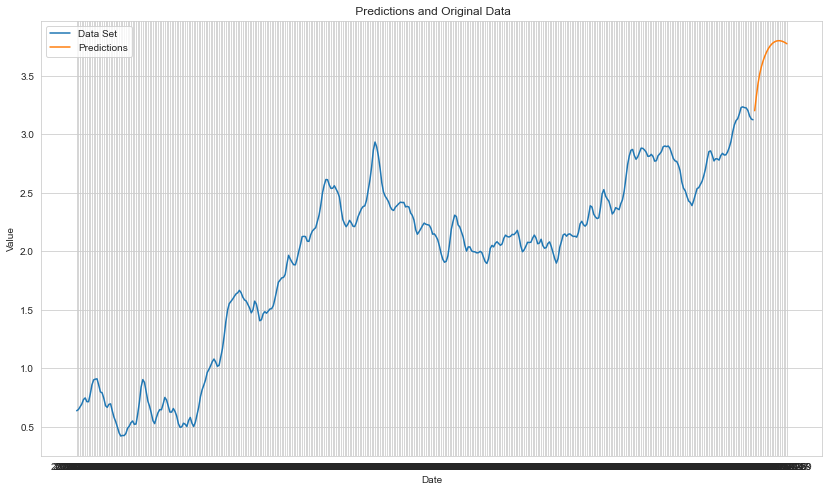

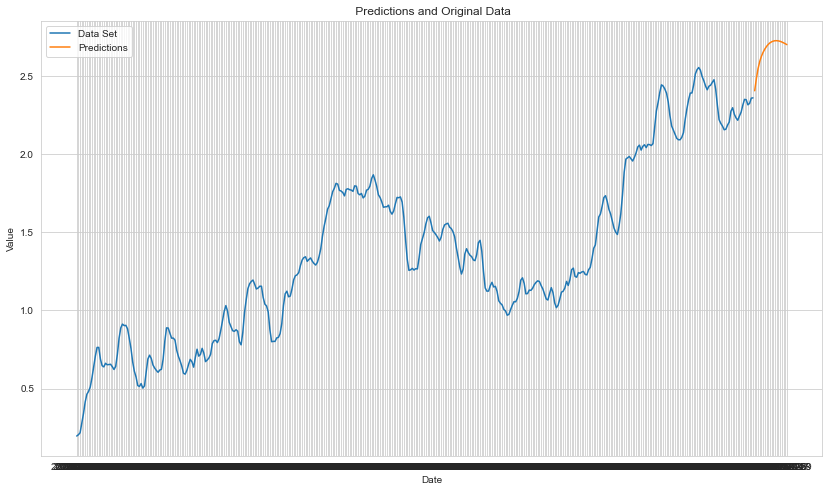

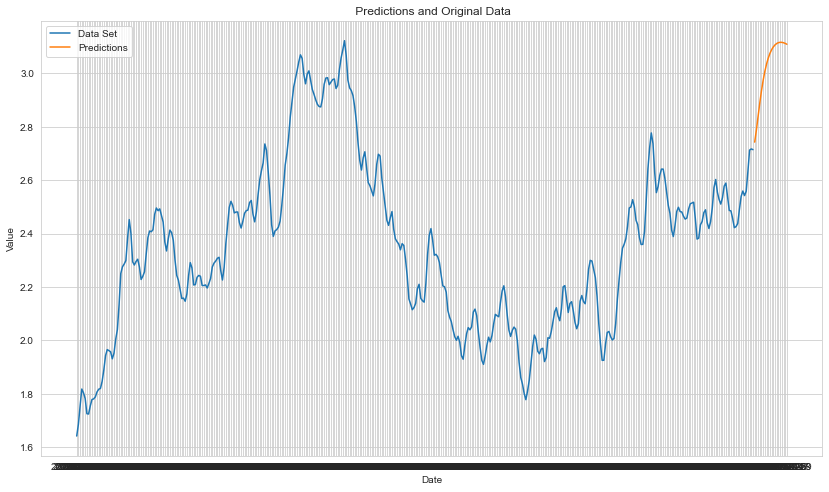

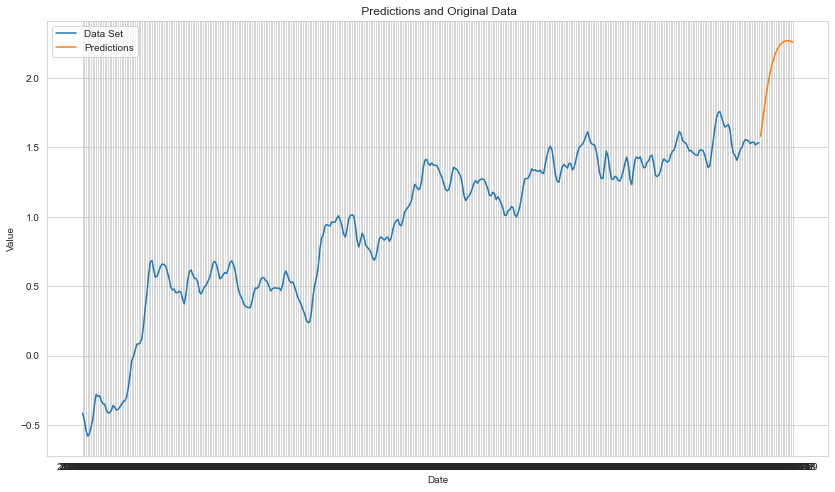

...

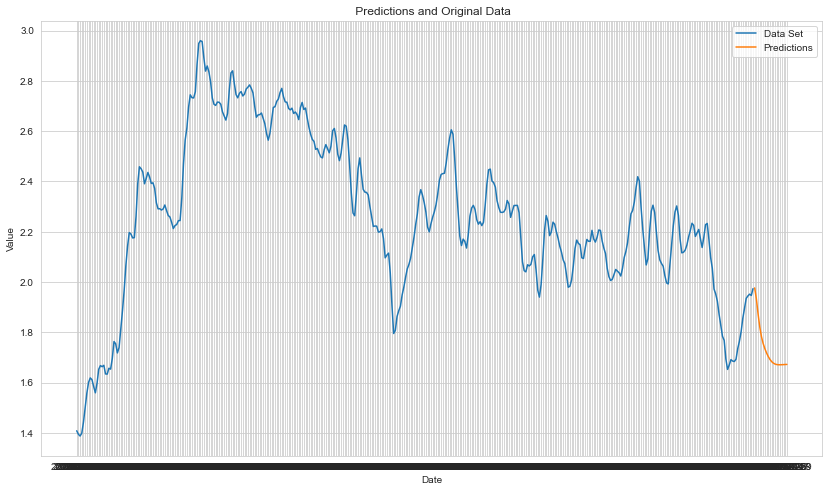

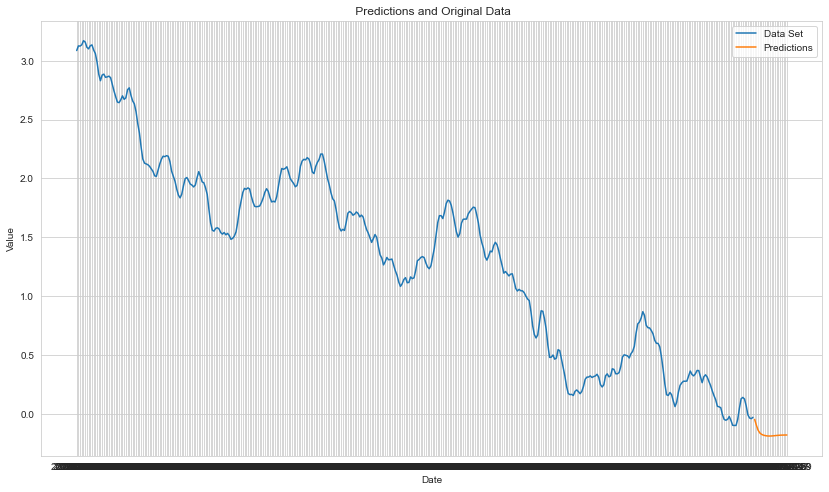

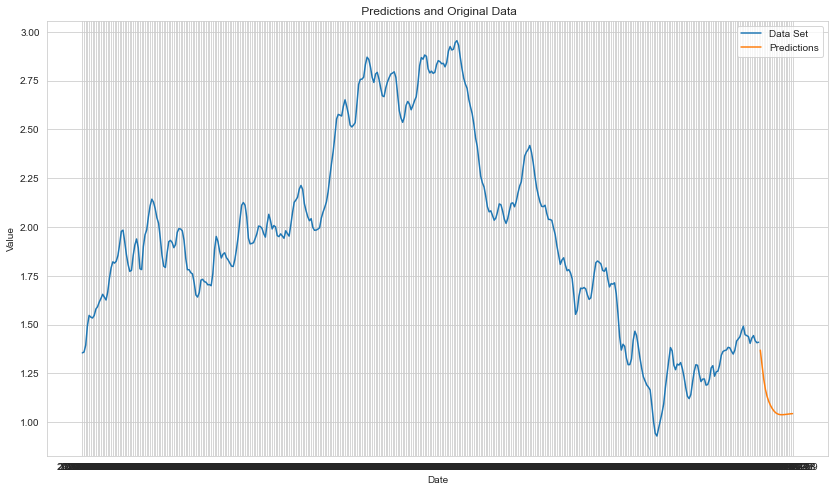

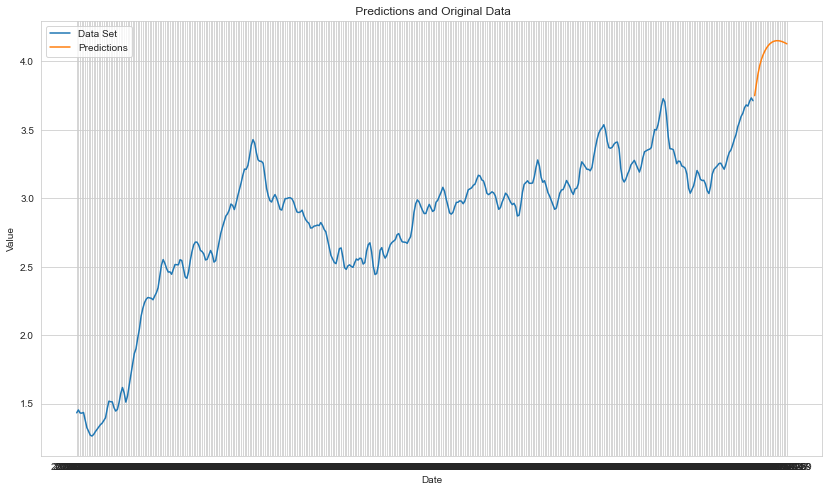

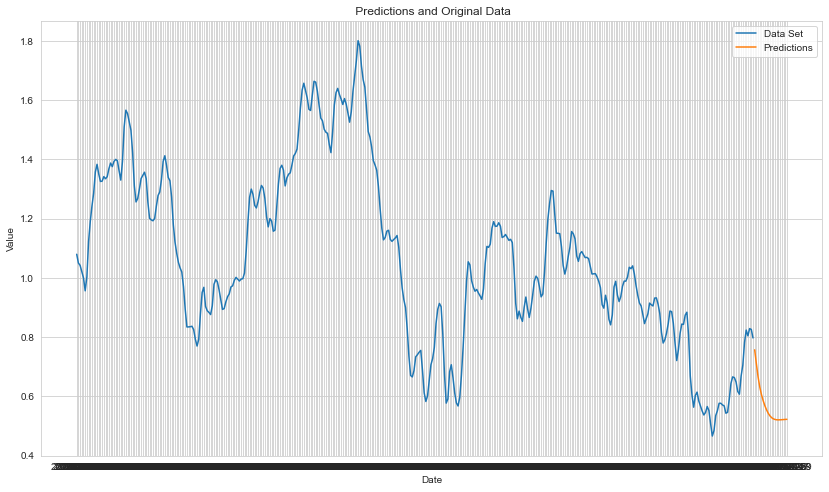

In [30]:
for ent in entity_list:
    plt.figure(figsize=(14,8))
    plt.plot(train_full_df[ent])
    plt.plot(market1_pred[ent])
    plt.ylabel("Value")
    plt.xlabel("Date")
    plt.legend(["Data Set", "Predictions"])
    plt.title(" Predictions and Original Data")

# Market 2
>The data is very similar to market1, so the data preparation and overall process is identical. 

In [6]:
market2 = pd.read_csv('./market2_train.csv', index_col=0)
market2.tail()

,ID100,ID101,ID102,ID103,ID104,ID105,ID106,ID107,ID108,ID109,...,ID190,ID191,ID192,ID193,ID194,ID195,ID196,ID197,ID198,ID199
2021-07-05,-0.615143,3.375599,-3.172252,2.673273,-2.167257,0.075858,-3.327457,1.310824,-1.461301,1.361732,...,0.549661,4.553448,-2.558080,-1.567022,0.484059,0.223102,0.268324,1.636028,-1.412538,-1.794117
2021-07-06,-0.621667,3.373319,-3.151161,2.642860,-2.145078,0.099093,-3.410279,1.365043,-1.530922,1.301718,...,0.522389,4.562694,-2.593431,-1.522245,0.488986,0.203438,0.295143,1.555979,-1.512298,-1.870934
2021-07-07,-0.651792,3.369411,-3.093002,2.572803,-2.089159,0.051647,-3.503021,1.419525,-1.599515,1.314128,...,0.445557,4.489319,-2.629857,-1.576435,0.454626,0.189464,0.262271,1.421856,-1.595485,-1.951770
2021-07-08,-0.651027,3.396121,-3.053060,2.529802,-2.067004,-0.043020,-3.517867,1.518505,-1.623475,1.439887,...,0.366103,4.484172,-2.652675,-1.599746,0.410990,0.220415,0.246241,1.319105,-1.609226,-2.045787
2021-07-09,-0.642755,3.433528,-3.068779,2.542018,-2.024759,-0.087556,-3.512458,1.532683,-1.637972,1.526459,...,0.385293,4.553000,-2.679993,-1.658373,0.385610,0.276029,0.194704,1.322729,-1.623908,-2.133084


In [7]:
market2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 400 entries, 2020-06-05 to 2021-07-09
Data columns (total 100 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   ID100   400 non-null    float64
 1   ID101   400 non-null    float64
 2   ID102   400 non-null    float64
 3   ID103   400 non-null    float64
 4   ID104   400 non-null    float64
 5   ID105   400 non-null    float64
 6   ID106   400 non-null    float64
 7   ID107   400 non-null    float64
 8   ID108   400 non-null    float64
 9   ID109   400 non-null    float64
 10  ID110   400 non-null    float64
 11  ID111   400 non-null    float64
 12  ID112   400 non-null    float64
 13  ID113   400 non-null    float64
 14  ID114   400 non-null    float64
 15  ID115   400 non-null    float64
 16  ID116   400 non-null    float64
 17  ID117   400 non-null    float64
 18  ID118   400 non-null    float64
 19  ID119   400 non-null    float64
 20  ID120   400 non-null    float64
 21  ID121   400 non-null    flo

In [8]:
market2.isnull().values.any()

False

### Time Saver
> The data from market two is very similar to market1 so I will rename market2 market1 in order to reuse the code rather than rewrite it. The only code I will change is the model architecture. I will be using a GRU rather than LSTM. 
>
> - Ideally I would change this process to functions and classes for portability, but the time constraints do not allow for it.

In [9]:
market1 = market2.copy()

Text(0.5, 1.0, ' All Data')

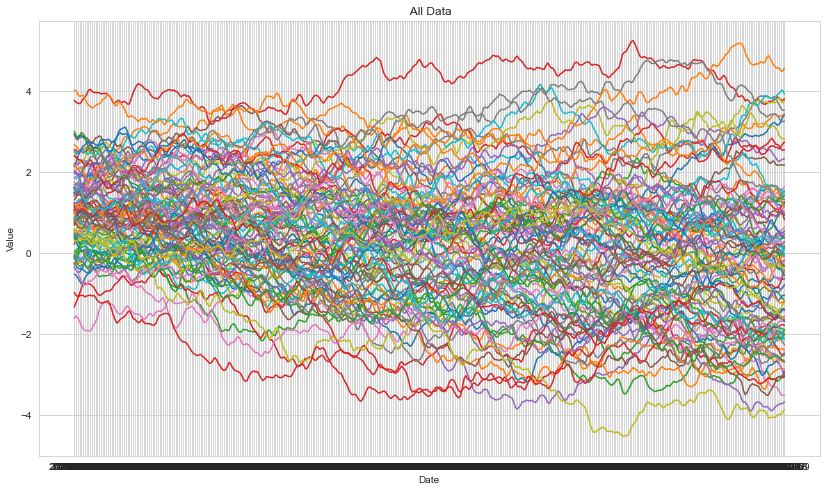

In [10]:
plt.figure(figsize=(14,8))
plt.plot(market1)
plt.ylabel("Value")
plt.xlabel("Date")
plt.title(" All Data")

## Split Data

In [11]:
train_df = market1.iloc[:300,:].copy()
val_df =  market1.iloc[300:,: ].copy() 
print(train_df.shape, val_df.shape)                       

(300, 100) (100, 100)


Text(0.5, 1.0, ' Split')

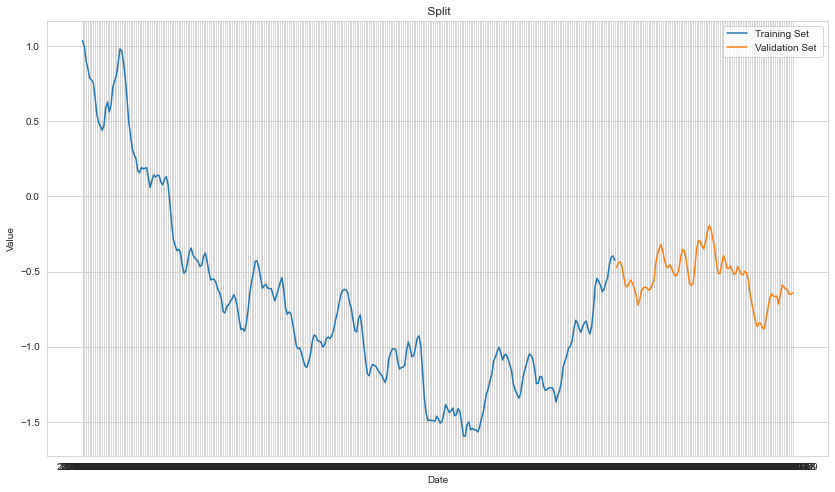

In [12]:
plt.figure(figsize=(14,8))
plt.plot(train_df['ID100'])
plt.plot(val_df['ID100'])
plt.ylabel("Value")
plt.xlabel("Date")
plt.legend(["Training Set", "Validation Set "])
plt.title(" Split")

## Winsorize Data

In [13]:
# lower_cutoff = train_df.quantile(0.01)
# upper_cutoff = train_df.quantile(0.99)

# train_df.clip(lower_cutoff, upper_cutoff, axis = 1, inplace = True )
# val_df.clip(lower_cutoff, upper_cutoff, axis = 1, inplace = True )

## Normalize Data

In [14]:
train_mean = train_df.mean()
train_std = train_df.std()

train_df = (train_df - train_mean) / train_std
val_df = (val_df - train_mean) / train_std

## Reshape Data

In [15]:
entity_list = train_df.columns
train_temp = {}
val_temp = {}


for ent in entity_list:
    train_temp[ent] = np.array(train_df[ent]).reshape(train_df.shape[0],1)
    val_temp[ent] = np.array(val_df[ent]).reshape(val_df.shape[0],1)
    
print(train_temp['ID100'].shape, val_temp['ID100'].shape)

(300, 1) (100, 1)


In [16]:
train_dict = {}
val_dict = {}

for ent in entity_list:
    train_dict[ent] = {}
    val_dict[ent] = {}
    X_train = []
    y_train = []
    
    win_len = 50 
    
    for i in range(win_len, 300):
        X_train.append(train_temp[ent][i-win_len:i,0])
        y_train.append(train_temp[ent][i,0])
        
    X_train, y_train = np.array(X_train), np.array(y_train)
    train_dict[ent]["X"] = np.reshape(X_train, (X_train.shape[0],X_train.shape[1],1))
    train_dict[ent]["y"] = y_train
    
    val_dict[ent] = {}
    X_val = []
    y_val = []    
    for i in range(win_len, 100):
        X_val.append(val_temp[ent][i-win_len:i,0])
        y_val.append(val_temp[ent][i,0])
        
    X_val, y_val = np.array(X_val), np.array(y_val)
    val_dict[ent]["X"] = np.reshape(X_val, (X_val.shape[0], X_val.shape[1], 1))
    val_dict[ent]["y"] = y_val

In [17]:
arr_buff = []
for ent in entity_list:
    buff = {}
    buff["X_train"] = train_dict[ent]["X"].shape
    buff["y_train"] = train_dict[ent]["y"].shape
    buff["X_val"] = val_dict[ent]["X"].shape
    buff["y_val"] = val_dict[ent]["y"].shape
    arr_buff.append(buff)

pd.DataFrame(arr_buff, index=entity_list)

,X_train,y_train,X_val,y_val
ID100,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID101,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID102,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID103,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID104,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
...,...,...,...,...
ID195,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID196,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID197,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"
ID198,"(250, 50, 1)","(250,)","(50, 50, 1)","(50,)"


## Model
> The second model is a TensorFlow GRU model, another classic time-series model.

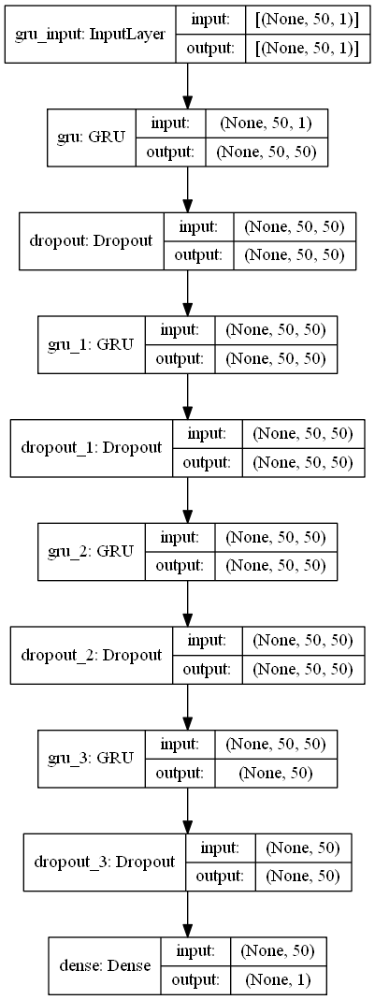

In [34]:
GRU_mod = Sequential()
GRU_mod.add(GRU(units=50, return_sequences=True, input_shape=(X_train.shape[1],1), activation='relu'))
GRU_mod.add(Dropout(0.2))
GRU_mod.add(GRU(units=50, return_sequences=True, input_shape=(X_train.shape[1],1), activation='relu'))
GRU_mod.add(Dropout(0.2))
GRU_mod.add(GRU(units=50, return_sequences=True, input_shape=(X_train.shape[1],1), activation='relu'))
GRU_mod.add(Dropout(0.2))
GRU_mod.add(GRU(units=50, activation='relu'))
GRU_mod.add(Dropout(0.5))
GRU_mod.add(Dense(units=1))

#GRU_mod.summary()
tf.keras.utils.plot_model(GRU_mod, 'model.png', show_shapes = True)

## Cyclical Learning Rate
> I added this to help with an exploding gradient problem. More information can be found at https://arxiv.org/abs/1506.01186
>
> The original author of the callback is Bradley Kenstler from https://github.com/bckenstler/CLR

In [26]:
from tensorflow.keras.callbacks import *
from tensorflow.keras import backend as K
import numpy as np

class CyclicLR(Callback):
    """
    from https://github.com/bckenstler/CLR
    
    Copyright (c) 2017 Bradley Kenstler

    Permission is hereby granted, free of charge, to any person obtaining a copy
    of this software and associated documentation files (the "Software"), to deal
    in the Software without restriction, including without limitation the rights
    to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
    copies of the Software, and to permit persons to whom the Software is
    furnished to do so, subject to the following conditions:
    
    # About
    This callback implements a cyclical learning rate policy (CLR).
    The method cycles the learning rate between two boundaries with
    some constant frequency, as detailed in this paper (https://arxiv.org/abs/1506.01186).
    The amplitude of the cycle can be scaled on a per-iteration or 
    per-cycle basis.
    This class has three built-in policies, as put forth in the paper.
    "triangular":
        A basic triangular cycle w/ no amplitude scaling.
    "triangular2":
        A basic triangular cycle that scales initial amplitude by half each cycle.
    "exp_range":
        A cycle that scales initial amplitude by gamma**(cycle iterations) at each 
        cycle iteration.
    For more detail, please see paper.
    
    # Example
        ```python
            clr = CyclicLR(base_lr=0.001, max_lr=0.006,
                                step_size=2000., mode='triangular')
            model.fit(X_train, Y_train, callbacks=[clr])
        ```
    
    Class also supports custom scaling functions:
        ```python
            clr_fn = lambda x: 0.5*(1+np.sin(x*np.pi/2.))
            clr = CyclicLR(base_lr=0.001, max_lr=0.006,
                                step_size=2000., scale_fn=clr_fn,
                                scale_mode='cycle')
            model.fit(X_train, Y_train, callbacks=[clr])
        ```    
    # Arguments
        base_lr: initial learning rate which is the
            lower boundary in the cycle.
        max_lr: upper boundary in the cycle. Functionally,
            it defines the cycle amplitude (max_lr - base_lr).
            The lr at any cycle is the sum of base_lr
            and some scaling of the amplitude; therefore 
            max_lr may not actually be reached depending on
            scaling function.
        step_size: number of training iterations per
            half cycle. Authors suggest setting step_size
            2-8 x training iterations in epoch.
        mode: one of {triangular, triangular2, exp_range}.
            Default 'triangular'.
            Values correspond to policies detailed above.
            If scale_fn is not None, this argument is ignored.
        gamma: constant in 'exp_range' scaling function:
            gamma**(cycle iterations)
        scale_fn: Custom scaling policy defined by a single
            argument lambda function, where 
            0 <= scale_fn(x) <= 1 for all x >= 0.
            mode paramater is ignored 
        scale_mode: {'cycle', 'iterations'}.
            Defines whether scale_fn is evaluated on 
            cycle number or cycle iterations (training
            iterations since start of cycle). Default is 'cycle'.
    """

    def __init__(self, base_lr=0.001, max_lr=0.006, step_size=2000., mode='triangular',
                 gamma=1., scale_fn=None, scale_mode='cycle'):
        super(CyclicLR, self).__init__()

        self.base_lr = base_lr
        self.max_lr = max_lr
        self.step_size = step_size
        self.mode = mode
        self.gamma = gamma
        if scale_fn == None:
            if self.mode == 'triangular':
                self.scale_fn = lambda x: 1.
                self.scale_mode = 'cycle'
            elif self.mode == 'triangular2':
                self.scale_fn = lambda x: 1/(2.**(x-1))
                self.scale_mode = 'cycle'
            elif self.mode == 'exp_range':
                self.scale_fn = lambda x: gamma**(x)
                self.scale_mode = 'iterations'
        else:
            self.scale_fn = scale_fn
            self.scale_mode = scale_mode
        self.clr_iterations = 0.
        self.trn_iterations = 0.
        self.history = {}

        self._reset()

    def _reset(self, new_base_lr=None, new_max_lr=None,
               new_step_size=None):
        """Resets cycle iterations.
        Optional boundary/step size adjustment.
        """
        if new_base_lr != None:
            self.base_lr = new_base_lr
        if new_max_lr != None:
            self.max_lr = new_max_lr
        if new_step_size != None:
            self.step_size = new_step_size
        self.clr_iterations = 0.
        
    def clr(self):
        cycle = np.floor(1+self.clr_iterations/(2*self.step_size))
        x = np.abs(self.clr_iterations/self.step_size - 2*cycle + 1)
        if self.scale_mode == 'cycle':
            return self.base_lr + (self.max_lr-self.base_lr)*np.maximum(0, (1-x))*self.scale_fn(cycle)
        else:
            return self.base_lr + (self.max_lr-self.base_lr)*np.maximum(0, (1-x))*self.scale_fn(self.clr_iterations)
        
    def on_train_begin(self, logs={}):
        logs = logs or {}

        if self.clr_iterations == 0:
            K.set_value(self.model.optimizer.lr, self.base_lr)
        else:
            K.set_value(self.model.optimizer.lr, self.clr())        
            
    def on_batch_end(self, epoch, logs=None):
        
        logs = logs or {}
        self.trn_iterations += 1
        self.clr_iterations += 1

        self.history.setdefault('lr', []).append(K.get_value(self.model.optimizer.lr))
        self.history.setdefault('iterations', []).append(self.trn_iterations)

        for k, v in logs.items():
            self.history.setdefault(k, []).append(v)
        
        K.set_value(self.model.optimizer.lr, self.clr())

## GRU Validation Model

In [36]:
# GRU_mod.compile(optimizer=SGD(lr=0.01, decay=1e-7, momentum=0.9, nesterov=False, clipvalue=0.5),
#                 loss='mean_squared_error')

GRU_mod.compile(optimizer='rmsprop',loss='mean_squared_error')

clr_triangular = CyclicLR ( base_lr=0.001, 
                            max_lr=0.01,
                            step_size=2.,mode='triangular') 

# Fit
for ent in entity_list:
    print("Fitting ", ent)
    tf.keras.backend.clear_session()
    gc.collect()
    
    GRU_mod.fit(train_dict[ent]["X"], train_dict[ent]["y"], 
                 epochs=10,    #20
                 batch_size=100,
                 #callbacks=[clr_triangular]
               )

Fitting  ID100
Epoch 1/10
3/3 [==============================] - 11s 1s/step - loss: 0.3821
Epoch 2/10
3/3 [==============================] - 3s 1s/step - loss: 0.2171
Epoch 3/10
3/3 [==============================] - 3s 1s/step - loss: 0.1315
Epoch 4/10
3/3 [==============================] - 5s 2s/step - loss: 0.1130
Epoch 5/10
3/3 [==============================] - 4s 1s/step - loss: 0.1081
Epoch 6/10
3/3 [==============================] - 3s 1s/step - loss: 0.1004
Epoch 7/10
3/3 [==============================] - 3s 1s/step - loss: 0.1035
Epoch 8/10
3/3 [==============================] - 3s 1s/step - loss: 0.0841
Epoch 9/10
3/3 [==============================] - 3s 1s/step - loss: 0.0865
Epoch 10/10
3/3 [==============================] - 3s 1s/step - loss: 0.0847
Fitting  ID101
Epoch 1/10
3/3 [==============================] - 5s 1s/step - loss: 0.4030
Epoch 2/10
3/3 [==============================] - 3s 998ms/step - loss: 0.3855
Epoch 3/10
3/3 [==============================] - 3s 

3/3 [==============================] - 5s 1s/step - loss: 0.0944
Epoch 2/10
3/3 [==============================] - 3s 1s/step - loss: 0.0967
Epoch 3/10
3/3 [==============================] - 4s 1s/step - loss: 0.0640
Epoch 4/10
3/3 [==============================] - 4s 1s/step - loss: 0.0558
Epoch 5/10
3/3 [==============================] - 4s 1s/step - loss: 0.0643
Epoch 6/10
3/3 [==============================] - 4s 1s/step - loss: 0.0754
Epoch 7/10
3/3 [==============================] - 4s 1s/step - loss: 0.0684
Epoch 8/10
3/3 [==============================] - 4s 1s/step - loss: 0.0991
Epoch 9/10
3/3 [==============================] - 4s 1s/step - loss: 0.0589
Epoch 10/10
3/3 [==============================] - 4s 1s/step - loss: 0.0820
Fitting  ID122
Epoch 1/10
3/3 [==============================] - 5s 1s/step - loss: 0.0876
Epoch 2/10
3/3 [==============================] - 4s 1s/step - loss: 0.0508
Epoch 3/10
3/3 [==============================] - 4s 1s/step - loss: 0.0525
Epoch 4

3/3 [==============================] - 5s 1s/step - loss: 0.0962
Epoch 2/10
3/3 [==============================] - 3s 1s/step - loss: 0.0608
Epoch 3/10
3/3 [==============================] - 3s 1s/step - loss: 0.0624
Epoch 4/10
3/3 [==============================] - 4s 1s/step - loss: 0.0522
Epoch 5/10
3/3 [==============================] - 3s 1s/step - loss: 0.0663
Epoch 6/10
3/3 [==============================] - 3s 1s/step - loss: 0.0656
Epoch 7/10
3/3 [==============================] - 4s 1s/step - loss: 0.0520
Epoch 8/10
3/3 [==============================] - 4s 1s/step - loss: 0.0611
Epoch 9/10
3/3 [==============================] - 5s 1s/step - loss: 0.0566
Epoch 10/10
3/3 [==============================] - 3s 1s/step - loss: 0.0667
Fitting  ID143
Epoch 1/10
3/3 [==============================] - 5s 1s/step - loss: 0.0586
Epoch 2/10
3/3 [==============================] - 3s 1s/step - loss: 0.0586
Epoch 3/10
3/3 [==============================] - 3s 1s/step - loss: 0.0603
Epoch 4

3/3 [==============================] - 5s 1s/step - loss: 0.0465
Epoch 2/10
3/3 [==============================] - 3s 1s/step - loss: 0.0317
Epoch 3/10
3/3 [==============================] - 3s 1s/step - loss: 0.0361
Epoch 4/10
3/3 [==============================] - 3s 1s/step - loss: 0.0421
Epoch 5/10
3/3 [==============================] - 4s 1s/step - loss: 0.0379
Epoch 6/10
3/3 [==============================] - 3s 1s/step - loss: 0.0319
Epoch 7/10
3/3 [==============================] - 3s 1s/step - loss: 0.0266
Epoch 8/10
3/3 [==============================] - 4s 1s/step - loss: 0.0392
Epoch 9/10
3/3 [==============================] - 4s 1s/step - loss: 0.0353
Epoch 10/10
3/3 [==============================] - 3s 1s/step - loss: 0.0387
Fitting  ID164
Epoch 1/10
3/3 [==============================] - 5s 1s/step - loss: 0.0721
Epoch 2/10
3/3 [==============================] - 3s 1s/step - loss: 0.0627
Epoch 3/10
3/3 [==============================] - 4s 1s/step - loss: 0.0735
Epoch 4

3/3 [==============================] - 5s 1s/step - loss: 0.0453
Epoch 2/10
3/3 [==============================] - 3s 1s/step - loss: 0.0506
Epoch 3/10
3/3 [==============================] - 3s 1s/step - loss: 0.0599
Epoch 4/10
3/3 [==============================] - 4s 1s/step - loss: 0.0435
Epoch 5/10
3/3 [==============================] - 4s 1s/step - loss: 0.0505
Epoch 6/10
3/3 [==============================] - 3s 1s/step - loss: 0.0490
Epoch 7/10
3/3 [==============================] - 4s 1s/step - loss: 0.0418
Epoch 8/10
3/3 [==============================] - 3s 1s/step - loss: 0.0516
Epoch 9/10
3/3 [==============================] - 4s 1s/step - loss: 0.0523
Epoch 10/10
3/3 [==============================] - 3s 1s/step - loss: 0.0538
Fitting  ID185
Epoch 1/10
3/3 [==============================] - 5s 1s/step - loss: 0.0423
Epoch 2/10
3/3 [==============================] - 3s 1s/step - loss: 0.0401
Epoch 3/10
3/3 [==============================] - 4s 1s/step - loss: 0.0344
Epoch 4

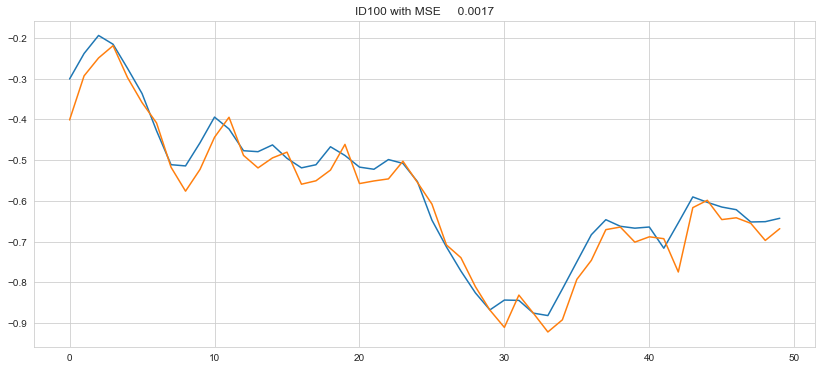

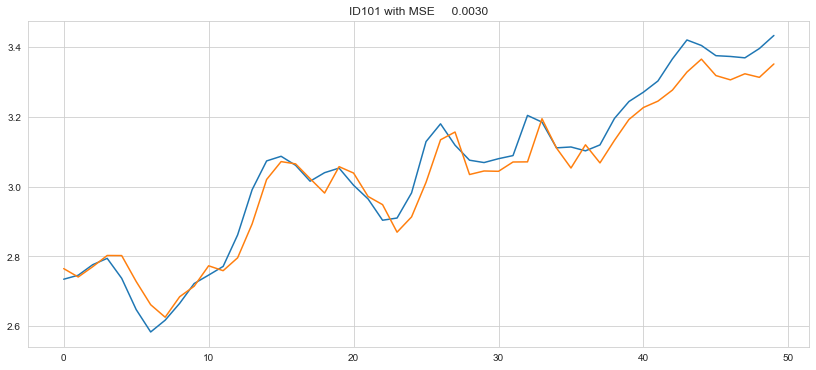

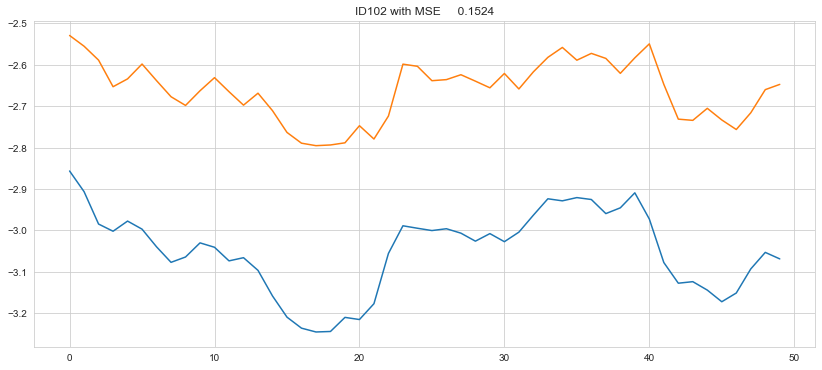

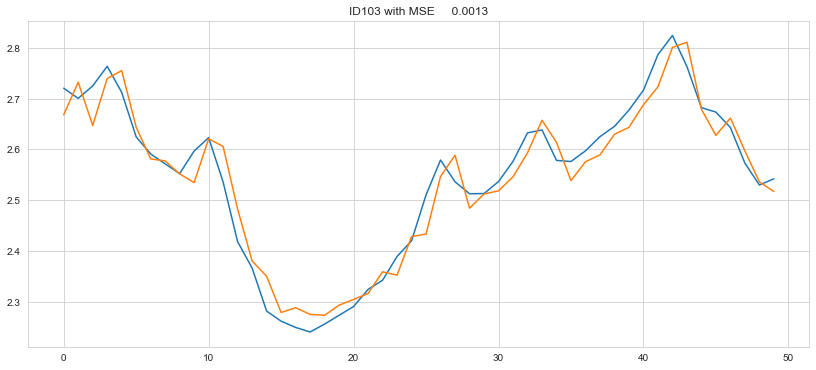

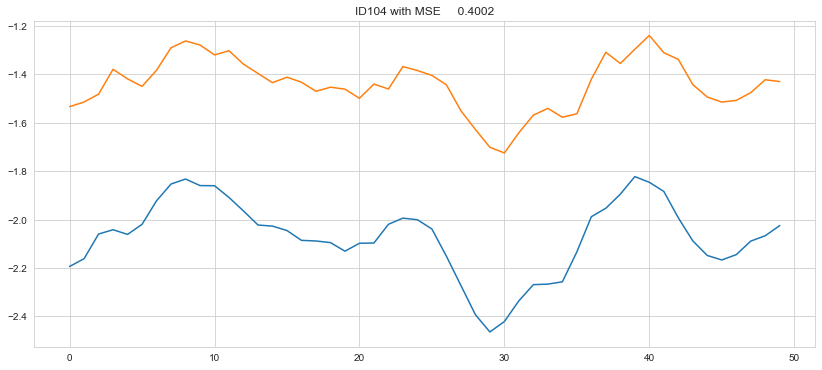

...

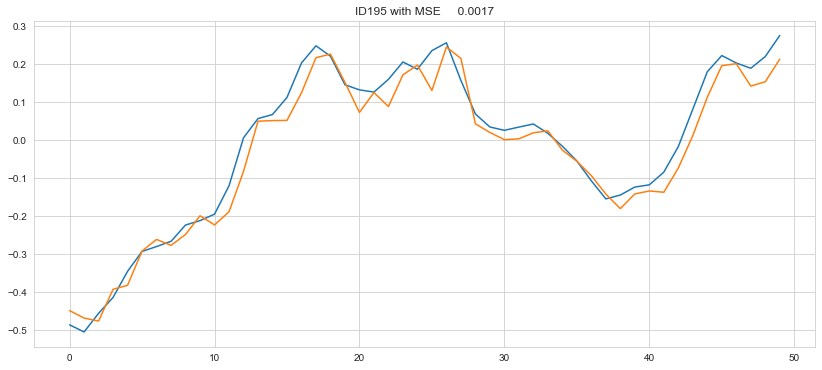

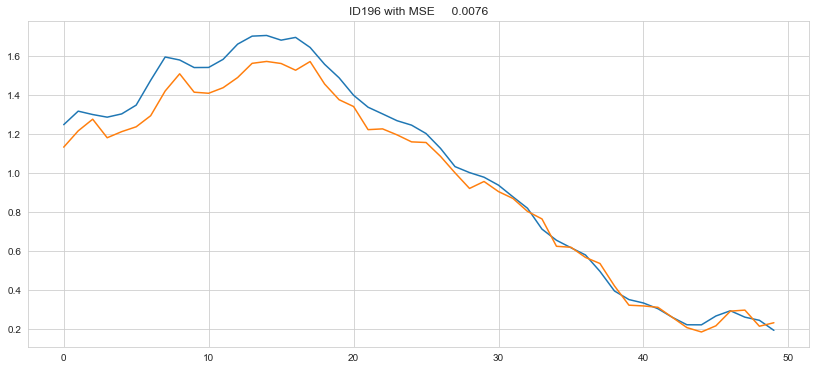

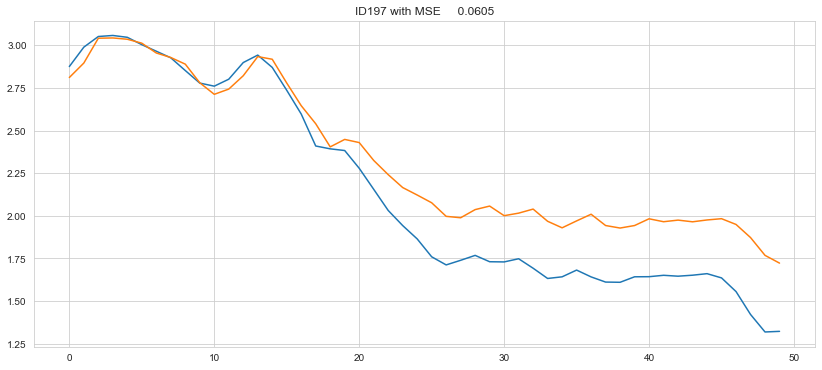

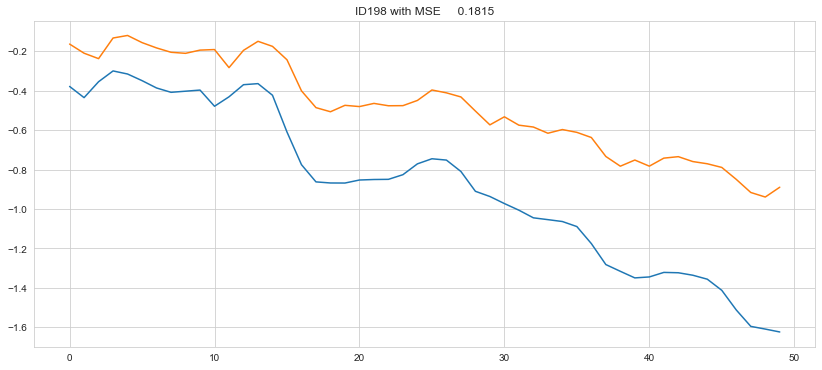

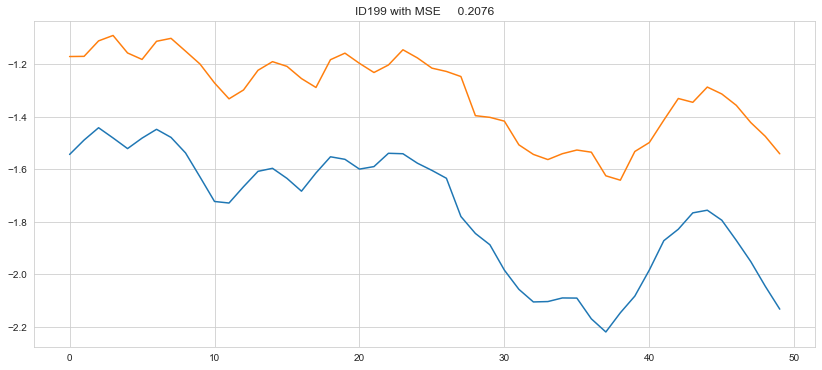

In [37]:
pred_result = {}
overall_MSE = []

for ent in entity_list:
    y_true = ((val_dict[ent]["y"].reshape(-1,1)) * train_std[ent]) + train_mean[ent]
    y_pred = ((GRU_mod.predict(val_dict[ent]["X"])) * train_std[ent]) + train_mean[ent]
    
    MSE = mean_squared_error(y_true, y_pred)
    plt.figure(figsize=(14,6))
    plt.title("{} with MSE {:10.4f}".format(ent,MSE))
    plt.plot(y_true)
    plt.plot(y_pred)
    
    overall_MSE.append(MSE)
    pred_result[ent] = {}
    pred_result[ent]['MSE']  = MSE
    pred_result[ent]["True"] = y_true
    pred_result[ent]["Pred"] = y_pred       

In [38]:
#MSE on validatin data
#20 .0042, med=.0037
#20noclr .0045 .0034

print('Min MSE:    {0:.4f}\nMax MSE:    {1:.4f}\nMedian MSE: {2:.4f}\nMean MSE:   {3:.4f}'.format(np.min(overall_MSE), 
                                                                                                  np.max(overall_MSE), 
                                                                                                  np.median(overall_MSE), 
                                                                                                  np.mean(overall_MSE)))

Min MSE:    0.0013
Max MSE:    0.9560
Median MSE: 0.0429
Mean MSE:   0.1351


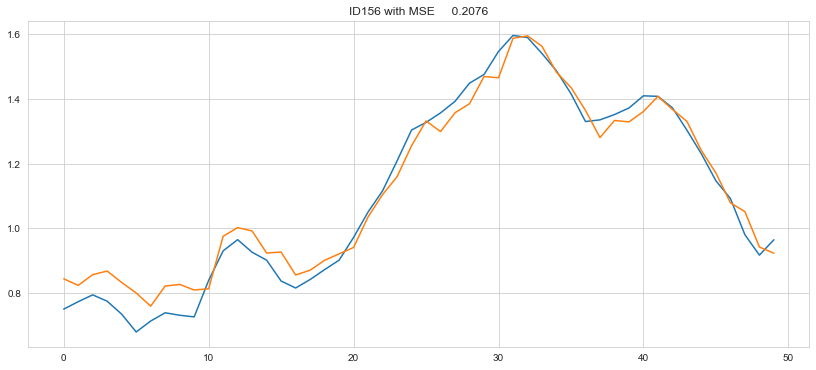

In [43]:
ent = 'ID156'

plt.figure(figsize=(14,6))
plt.title("{} with MSE {:10.4f}".format(ent,MSE))
plt.plot(pred_result[ent]["True"])
plt.plot(pred_result[ent]["Pred"])

# Final GRU Model

### Final Data

In [18]:
#Normalize

train_full_df = market1.copy()
full_mean = train_full_df.mean()
full_std = train_full_df.std()

train_full_df = (train_full_df - full_mean) / full_std
train_full_df.shape

(400, 100)

In [19]:
#Reshape

entity_list = train_full_df.columns
train_full_temp = {}


for ent in entity_list:
    train_full_temp[ent] = np.array(train_full_df[ent]).reshape(train_full_df.shape[0],1)
    
print(train_full_temp['ID100'].shape)

(400, 1)


In [20]:
train_full_dict = {}

for ent in entity_list:
    train_full_dict[ent] = {}
    X_train = []
    y_train = []
    
    win_len = 50 
    
    for i in range(win_len, 400):
        X_train.append(train_full_temp[ent][i-win_len:i,0])
        y_train.append(train_full_temp[ent][i,0])
        
    X_train, y_train = np.array(X_train), np.array(y_train)
    train_full_dict[ent]["X"] = np.reshape(X_train, (X_train.shape[0],X_train.shape[1],1))
    train_full_dict[ent]["y"] = y_train

In [21]:
arr_buff = []
for ent in entity_list:
    buff = {}
    buff["X_train"] = train_full_dict[ent]["X"].shape
    buff["y_train"] = train_full_dict[ent]["y"].shape
    #buff["X_val"] = train_full_dict[ent]["X"].shape
    #buff["y_val"] = train_full_dict[ent]["y"].shape
    arr_buff.append(buff)

pd.DataFrame(arr_buff, index=entity_list)

,X_train,y_train
ID100,"(350, 50, 1)","(350,)"
ID101,"(350, 50, 1)","(350,)"
ID102,"(350, 50, 1)","(350,)"
ID103,"(350, 50, 1)","(350,)"
ID104,"(350, 50, 1)","(350,)"
...,...,...
ID195,"(350, 50, 1)","(350,)"
ID196,"(350, 50, 1)","(350,)"
ID197,"(350, 50, 1)","(350,)"
ID198,"(350, 50, 1)","(350,)"


## Final Model

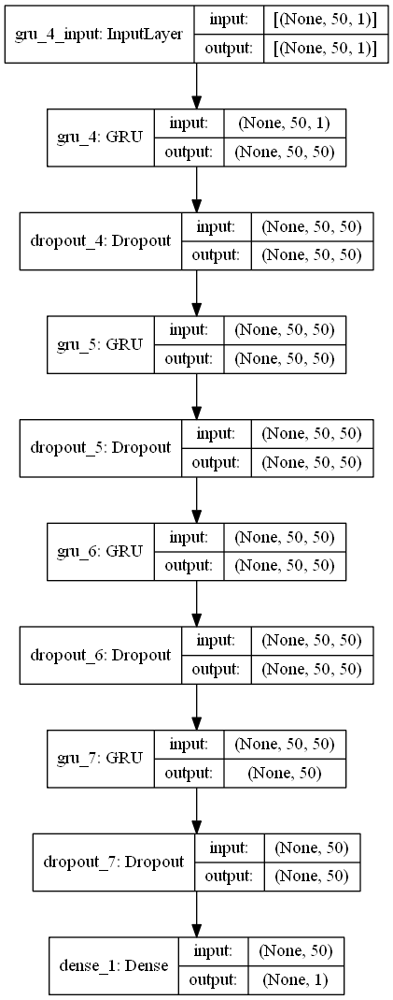

In [25]:
GRU_mod_F = Sequential()
GRU_mod_F.add(GRU(units=50, return_sequences=True, input_shape=(X_train.shape[1],1), activation='relu'))
GRU_mod_F.add(Dropout(0.2))
GRU_mod_F.add(GRU(units=50, return_sequences=True, input_shape=(X_train.shape[1],1), activation='relu'))
GRU_mod_F.add(Dropout(0.2))
GRU_mod_F.add(GRU(units=50, return_sequences=True, input_shape=(X_train.shape[1],1), activation='relu'))
GRU_mod_F.add(Dropout(0.2))
GRU_mod_F.add(GRU(units=50, activation='relu'))
GRU_mod_F.add(Dropout(0.5))
GRU_mod_F.add(Dense(units=1))

#GRU_mod.summary()
tf.keras.utils.plot_model(GRU_mod_F, 'model.png', show_shapes = True)

## Initial Fit 

In [29]:
#GRU_mod_F.compile(optimizer=SGD(lr=0.01, decay=1e-7, momentum=0.9, nesterov=False, clipvalue=0.5),loss='mean_squared_error')

GRU_mod_F.compile(optimizer='rmsprop',loss='mean_squared_error')

clr_triangular = CyclicLR ( base_lr=0.001, 
                            max_lr=0.01,
                            step_size=2.,mode='triangular')

for ent in entity_list:
    print("Fitting ", ent)
    tf.keras.backend.clear_session()
    gc.collect()
    
    GRU_mod_F.fit(train_full_dict[ent]["X"], train_full_dict[ent]["y"], 
                 epochs=10, 
                 batch_size=100, 
                 #callbacks = [clr_triangular]
                 )

Fitting  ID100
Epoch 1/10
4/4 [==============================] - 12s 1s/step - loss: 0.1343
Epoch 2/10
4/4 [==============================] - 5s 1s/step - loss: 0.1030
Epoch 3/10
4/4 [==============================] - 5s 1s/step - loss: 0.0809
Epoch 4/10
4/4 [==============================] - 5s 1s/step - loss: 0.0808
Epoch 5/10
4/4 [==============================] - 4s 1s/step - loss: 0.0924
Epoch 6/10
4/4 [==============================] - 4s 1s/step - loss: 0.0716
Epoch 7/10
4/4 [==============================] - 4s 1s/step - loss: 0.0821
Epoch 8/10
4/4 [==============================] - 4s 1s/step - loss: 0.0933
Epoch 9/10
4/4 [==============================] - 4s 1s/step - loss: 0.0810
Epoch 10/10
4/4 [==============================] - 6s 2s/step - loss: 0.0743
Fitting  ID101
Epoch 1/10
4/4 [==============================] - 6s 1s/step - loss: 0.3585
Epoch 2/10
4/4 [==============================] - 5s 1s/step - loss: 0.2650
Epoch 3/10
4/4 [==============================] - 6s 2s/

4/4 [==============================] - 8s 1s/step - loss: 0.0739
Epoch 2/10
4/4 [==============================] - 7s 2s/step - loss: 0.0784
Epoch 3/10
4/4 [==============================] - 6s 1s/step - loss: 0.0810
Epoch 4/10
4/4 [==============================] - 6s 2s/step - loss: 0.0583
Epoch 5/10
4/4 [==============================] - 5s 1s/step - loss: 0.0634
Epoch 6/10
4/4 [==============================] - 6s 2s/step - loss: 0.0721
Epoch 7/10
4/4 [==============================] - 6s 1s/step - loss: 0.0620
Epoch 8/10
4/4 [==============================] - 6s 2s/step - loss: 0.0577
Epoch 9/10
4/4 [==============================] - 8s 2s/step - loss: 0.0645
Epoch 10/10
4/4 [==============================] - 6s 2s/step - loss: 0.0610
Fitting  ID122
Epoch 1/10
4/4 [==============================] - 7s 1s/step - loss: 0.0551
Epoch 2/10
4/4 [==============================] - 6s 2s/step - loss: 0.0520
Epoch 3/10
4/4 [==============================] - 6s 1s/step - loss: 0.0540
Epoch 4

4/4 [==============================] - 10s 2s/step - loss: 0.0500
Epoch 2/10
4/4 [==============================] - 7s 2s/step - loss: 0.0413
Epoch 3/10
4/4 [==============================] - 8s 2s/step - loss: 0.0466
Epoch 4/10
4/4 [==============================] - 7s 2s/step - loss: 0.0459
Epoch 5/10
4/4 [==============================] - 7s 2s/step - loss: 0.0448
Epoch 6/10
4/4 [==============================] - 7s 2s/step - loss: 0.0570
Epoch 7/10
4/4 [==============================] - 6s 1s/step - loss: 0.0445
Epoch 8/10
4/4 [==============================] - 6s 1s/step - loss: 0.0480
Epoch 9/10
4/4 [==============================] - 5s 1s/step - loss: 0.0436
Epoch 10/10
4/4 [==============================] - 5s 1s/step - loss: 0.0557
Fitting  ID143
Epoch 1/10
4/4 [==============================] - 6s 1s/step - loss: 0.0728
Epoch 2/10
4/4 [==============================] - 6s 2s/step - loss: 0.0775
Epoch 3/10
4/4 [==============================] - 6s 1s/step - loss: 0.0739
Epoch 

4/4 [==============================] - 8s 2s/step - loss: 0.0442
Epoch 2/10
4/4 [==============================] - 7s 2s/step - loss: 0.0369
Epoch 3/10
4/4 [==============================] - 7s 2s/step - loss: 0.0354
Epoch 4/10
4/4 [==============================] - 7s 2s/step - loss: 0.0434
Epoch 5/10
4/4 [==============================] - 7s 2s/step - loss: 0.0319
Epoch 6/10
4/4 [==============================] - 7s 2s/step - loss: 0.0381
Epoch 7/10
4/4 [==============================] - 6s 2s/step - loss: 0.0308
Epoch 8/10
4/4 [==============================] - 7s 2s/step - loss: 0.0424
Epoch 9/10
4/4 [==============================] - 7s 2s/step - loss: 0.0420
Epoch 10/10
4/4 [==============================] - 7s 2s/step - loss: 0.0337
Fitting  ID164
Epoch 1/10
4/4 [==============================] - 8s 2s/step - loss: 0.0608
Epoch 2/10
4/4 [==============================] - 7s 2s/step - loss: 0.0661
Epoch 3/10
4/4 [==============================] - 7s 2s/step - loss: 0.0683
Epoch 4

4/4 [==============================] - 7s 1s/step - loss: 0.0504
Epoch 2/10
4/4 [==============================] - 5s 1s/step - loss: 0.0500
Epoch 3/10
4/4 [==============================] - 6s 1s/step - loss: 0.0459
Epoch 4/10
4/4 [==============================] - 6s 1s/step - loss: 0.0481
Epoch 5/10
4/4 [==============================] - 5s 1s/step - loss: 0.0415
Epoch 6/10
4/4 [==============================] - 5s 1s/step - loss: 0.0442
Epoch 7/10
4/4 [==============================] - 6s 1s/step - loss: 0.0541
Epoch 8/10
4/4 [==============================] - 6s 1s/step - loss: 0.0504
Epoch 9/10
4/4 [==============================] - 6s 2s/step - loss: 0.0550
Epoch 10/10
4/4 [==============================] - 6s 1s/step - loss: 0.0483
Fitting  ID185
Epoch 1/10
4/4 [==============================] - 7s 1s/step - loss: 0.0247
Epoch 2/10
4/4 [==============================] - 6s 1s/step - loss: 0.0265
Epoch 3/10
4/4 [==============================] - 6s 1s/step - loss: 0.0292
Epoch 4

## Autoregressive Predictions

In [30]:
n_forecast = 20  #20
rng = pd.date_range('2021-07-10', periods=n_forecast, freq='D').astype(str)
pred_df = pd.DataFrame(columns = entity_list, index=rng)

forecast_X = {}
forecast_y = {}

for ent in entity_list:    
    x = train_full_dict[ent]['X'][349][1:].reshape(-1, 49, 1)
    forecast_X[ent] = x
    forecast_y[ent] = train_full_dict[ent]['y'][-50:].reshape( 50, 1)

    
for ent in entity_list:
    for i in range(n_forecast):     
        
        if(i == 0):
            print('Initializing x,y')
            y = forecast_y[ent][-1]
            x = forecast_X[ent][0:]
            X = np.append(x, y).reshape(-1,50,1)
        print('Predicting {}  forecast period {} '.format( ent, i+1))
        
        y_pred = (GRU_mod_F.predict(X)) 

#         GRU_mod_F.fit(X, y_new, 
#                   epochs=1,    
#                   batch_size=50,
#                   #callbacks = [clr_triangular]
#                  ) 
        
        y_new = y_pred[0][:].reshape(-1,1)
        X = np.append(X[0][1:], y_new).reshape(-1,50,1)    
    
    #write to df
    print('Writing to df')
    pred_df[ent] = X[0][-n_forecast:]      

Initializing x,y
Predicting ID100  forecast period 1 
Predicting ID100  forecast period 2 
Predicting ID100  forecast period 3 
Predicting ID100  forecast period 4 
Predicting ID100  forecast period 5 
Predicting ID100  forecast period 6 
Predicting ID100  forecast period 7 
Predicting ID100  forecast period 8 
Predicting ID100  forecast period 9 
Predicting ID100  forecast period 10 
Predicting ID100  forecast period 11 
Predicting ID100  forecast period 12 
Predicting ID100  forecast period 13 
Predicting ID100  forecast period 14 
Predicting ID100  forecast period 15 
Predicting ID100  forecast period 16 
Predicting ID100  forecast period 17 
Predicting ID100  forecast period 18 
Predicting ID100  forecast period 19 
Predicting ID100  forecast period 20 
Writing to df
Initializing x,y
Predicting ID101  forecast period 1 
Predicting ID101  forecast period 2 
Predicting ID101  forecast period 3 
Predicting ID101  forecast period 4 
Predicting ID101  forecast period 5 
Predicting ID101

Predicting ID110  forecast period 11 
Predicting ID110  forecast period 12 
Predicting ID110  forecast period 13 
Predicting ID110  forecast period 14 
Predicting ID110  forecast period 15 
Predicting ID110  forecast period 16 
Predicting ID110  forecast period 17 
Predicting ID110  forecast period 18 
Predicting ID110  forecast period 19 
Predicting ID110  forecast period 20 
Writing to df
Initializing x,y
Predicting ID111  forecast period 1 
Predicting ID111  forecast period 2 
Predicting ID111  forecast period 3 
Predicting ID111  forecast period 4 
Predicting ID111  forecast period 5 
Predicting ID111  forecast period 6 
Predicting ID111  forecast period 7 
Predicting ID111  forecast period 8 
Predicting ID111  forecast period 9 
Predicting ID111  forecast period 10 
Predicting ID111  forecast period 11 
Predicting ID111  forecast period 12 
Predicting ID111  forecast period 13 
Predicting ID111  forecast period 14 
Predicting ID111  forecast period 15 
Predicting ID111  forecast p

Writing to df
Initializing x,y
Predicting ID121  forecast period 1 
Predicting ID121  forecast period 2 
Predicting ID121  forecast period 3 
Predicting ID121  forecast period 4 
Predicting ID121  forecast period 5 
Predicting ID121  forecast period 6 
Predicting ID121  forecast period 7 
Predicting ID121  forecast period 8 
Predicting ID121  forecast period 9 
Predicting ID121  forecast period 10 
Predicting ID121  forecast period 11 
Predicting ID121  forecast period 12 
Predicting ID121  forecast period 13 
Predicting ID121  forecast period 14 
Predicting ID121  forecast period 15 
Predicting ID121  forecast period 16 
Predicting ID121  forecast period 17 
Predicting ID121  forecast period 18 
Predicting ID121  forecast period 19 
Predicting ID121  forecast period 20 
Writing to df
Initializing x,y
Predicting ID122  forecast period 1 
Predicting ID122  forecast period 2 
Predicting ID122  forecast period 3 
Predicting ID122  forecast period 4 
Predicting ID122  forecast period 5 
Pr

Predicting ID131  forecast period 11 
Predicting ID131  forecast period 12 
Predicting ID131  forecast period 13 
Predicting ID131  forecast period 14 
Predicting ID131  forecast period 15 
Predicting ID131  forecast period 16 
Predicting ID131  forecast period 17 
Predicting ID131  forecast period 18 
Predicting ID131  forecast period 19 
Predicting ID131  forecast period 20 
Writing to df
Initializing x,y
Predicting ID132  forecast period 1 
Predicting ID132  forecast period 2 
Predicting ID132  forecast period 3 
Predicting ID132  forecast period 4 
Predicting ID132  forecast period 5 
Predicting ID132  forecast period 6 
Predicting ID132  forecast period 7 
Predicting ID132  forecast period 8 
Predicting ID132  forecast period 9 
Predicting ID132  forecast period 10 
Predicting ID132  forecast period 11 
Predicting ID132  forecast period 12 
Predicting ID132  forecast period 13 
Predicting ID132  forecast period 14 
Predicting ID132  forecast period 15 
Predicting ID132  forecast p

Writing to df
Initializing x,y
Predicting ID142  forecast period 1 
Predicting ID142  forecast period 2 
Predicting ID142  forecast period 3 
Predicting ID142  forecast period 4 
Predicting ID142  forecast period 5 
Predicting ID142  forecast period 6 
Predicting ID142  forecast period 7 
Predicting ID142  forecast period 8 
Predicting ID142  forecast period 9 
Predicting ID142  forecast period 10 
Predicting ID142  forecast period 11 
Predicting ID142  forecast period 12 
Predicting ID142  forecast period 13 
Predicting ID142  forecast period 14 
Predicting ID142  forecast period 15 
Predicting ID142  forecast period 16 
Predicting ID142  forecast period 17 
Predicting ID142  forecast period 18 
Predicting ID142  forecast period 19 
Predicting ID142  forecast period 20 
Writing to df
Initializing x,y
Predicting ID143  forecast period 1 
Predicting ID143  forecast period 2 
Predicting ID143  forecast period 3 
Predicting ID143  forecast period 4 
Predicting ID143  forecast period 5 
Pr

Predicting ID152  forecast period 11 
Predicting ID152  forecast period 12 
Predicting ID152  forecast period 13 
Predicting ID152  forecast period 14 
Predicting ID152  forecast period 15 
Predicting ID152  forecast period 16 
Predicting ID152  forecast period 17 
Predicting ID152  forecast period 18 
Predicting ID152  forecast period 19 
Predicting ID152  forecast period 20 
Writing to df
Initializing x,y
Predicting ID153  forecast period 1 
Predicting ID153  forecast period 2 
Predicting ID153  forecast period 3 
Predicting ID153  forecast period 4 
Predicting ID153  forecast period 5 
Predicting ID153  forecast period 6 
Predicting ID153  forecast period 7 
Predicting ID153  forecast period 8 
Predicting ID153  forecast period 9 
Predicting ID153  forecast period 10 
Predicting ID153  forecast period 11 
Predicting ID153  forecast period 12 
Predicting ID153  forecast period 13 
Predicting ID153  forecast period 14 
Predicting ID153  forecast period 15 
Predicting ID153  forecast p

Writing to df
Initializing x,y
Predicting ID163  forecast period 1 
Predicting ID163  forecast period 2 
Predicting ID163  forecast period 3 
Predicting ID163  forecast period 4 
Predicting ID163  forecast period 5 
Predicting ID163  forecast period 6 
Predicting ID163  forecast period 7 
Predicting ID163  forecast period 8 
Predicting ID163  forecast period 9 
Predicting ID163  forecast period 10 
Predicting ID163  forecast period 11 
Predicting ID163  forecast period 12 
Predicting ID163  forecast period 13 
Predicting ID163  forecast period 14 
Predicting ID163  forecast period 15 
Predicting ID163  forecast period 16 
Predicting ID163  forecast period 17 
Predicting ID163  forecast period 18 
Predicting ID163  forecast period 19 
Predicting ID163  forecast period 20 
Writing to df
Initializing x,y
Predicting ID164  forecast period 1 
Predicting ID164  forecast period 2 
Predicting ID164  forecast period 3 
Predicting ID164  forecast period 4 
Predicting ID164  forecast period 5 
Pr

Predicting ID173  forecast period 11 
Predicting ID173  forecast period 12 
Predicting ID173  forecast period 13 
Predicting ID173  forecast period 14 
Predicting ID173  forecast period 15 
Predicting ID173  forecast period 16 
Predicting ID173  forecast period 17 
Predicting ID173  forecast period 18 
Predicting ID173  forecast period 19 
Predicting ID173  forecast period 20 
Writing to df
Initializing x,y
Predicting ID174  forecast period 1 
Predicting ID174  forecast period 2 
Predicting ID174  forecast period 3 
Predicting ID174  forecast period 4 
Predicting ID174  forecast period 5 
Predicting ID174  forecast period 6 
Predicting ID174  forecast period 7 
Predicting ID174  forecast period 8 
Predicting ID174  forecast period 9 
Predicting ID174  forecast period 10 
Predicting ID174  forecast period 11 
Predicting ID174  forecast period 12 
Predicting ID174  forecast period 13 
Predicting ID174  forecast period 14 
Predicting ID174  forecast period 15 
Predicting ID174  forecast p

Predicting ID184  forecast period 2 
Predicting ID184  forecast period 3 
Predicting ID184  forecast period 4 
Predicting ID184  forecast period 5 
Predicting ID184  forecast period 6 
Predicting ID184  forecast period 7 
Predicting ID184  forecast period 8 
Predicting ID184  forecast period 9 
Predicting ID184  forecast period 10 
Predicting ID184  forecast period 11 
Predicting ID184  forecast period 12 
Predicting ID184  forecast period 13 
Predicting ID184  forecast period 14 
Predicting ID184  forecast period 15 
Predicting ID184  forecast period 16 
Predicting ID184  forecast period 17 
Predicting ID184  forecast period 18 
Predicting ID184  forecast period 19 
Predicting ID184  forecast period 20 
Writing to df
Initializing x,y
Predicting ID185  forecast period 1 
Predicting ID185  forecast period 2 
Predicting ID185  forecast period 3 
Predicting ID185  forecast period 4 
Predicting ID185  forecast period 5 
Predicting ID185  forecast period 6 
Predicting ID185  forecast period

Predicting ID194  forecast period 13 
Predicting ID194  forecast period 14 
Predicting ID194  forecast period 15 
Predicting ID194  forecast period 16 
Predicting ID194  forecast period 17 
Predicting ID194  forecast period 18 
Predicting ID194  forecast period 19 
Predicting ID194  forecast period 20 
Writing to df
Initializing x,y
Predicting ID195  forecast period 1 
Predicting ID195  forecast period 2 
Predicting ID195  forecast period 3 
Predicting ID195  forecast period 4 
Predicting ID195  forecast period 5 
Predicting ID195  forecast period 6 
Predicting ID195  forecast period 7 
Predicting ID195  forecast period 8 
Predicting ID195  forecast period 9 
Predicting ID195  forecast period 10 
Predicting ID195  forecast period 11 
Predicting ID195  forecast period 12 
Predicting ID195  forecast period 13 
Predicting ID195  forecast period 14 
Predicting ID195  forecast period 15 
Predicting ID195  forecast period 16 
Predicting ID195  forecast period 17 
Predicting ID195  forecast p

In [31]:
pred_df.head(3)

,ID100,ID101,ID102,ID103,ID104,ID105,ID106,ID107,ID108,ID109,...,ID190,ID191,ID192,ID193,ID194,ID195,ID196,ID197,ID198,ID199
2021-07-10,0.010133,1.438932,-1.040093,-0.065462,-1.000133,-1.843461,-2.306226,-0.699756,-1.978868,1.367731,...,0.019082,1.408572,-1.534639,0.585563,0.210974,0.887123,-0.663527,-1.794780,-2.503457,-1.186962
2021-07-11,-0.085918,0.918371,-0.785094,-0.107421,-0.770959,-1.211249,-1.441220,-0.723710,-1.259239,0.846446,...,-0.031861,0.903622,-1.032549,0.381145,0.105026,0.575815,-0.620614,-1.151907,-1.522488,-0.843647
2021-07-12,-0.215277,0.613968,-0.615078,-0.196689,-0.612576,-0.868346,-1.063441,-0.715756,-0.898579,0.547553,...,-0.120020,0.589759,-0.729495,0.249869,0.020699,0.336789,-0.585980,-0.810364,-1.135358,-0.625284


In [32]:
#restore mean and variance
market2_pred = (pred_df * full_std) + full_mean
train_full_df = (train_full_df * full_std) + full_mean

In [33]:
market2_pred.to_csv('market2_pred.csv', index=True)

Text(0.5, 1.0, ' Predictions and Original Data')

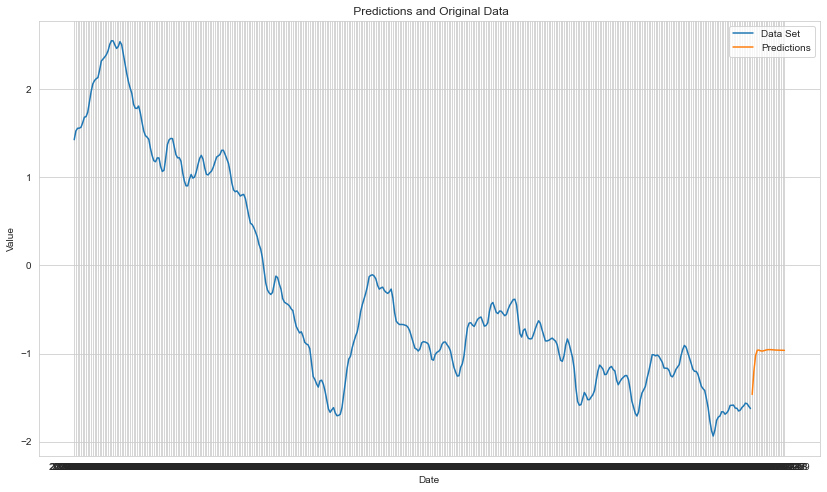

In [41]:
ID = 'ID115'

plt.figure(figsize=(14,8))
plt.plot(train_full_df[ID])
plt.plot(market2_pred[ID])
plt.ylabel("Value")
plt.xlabel("Date")
plt.legend(["Data Set", "Predictions"])
plt.title(" Predictions and Original Data")

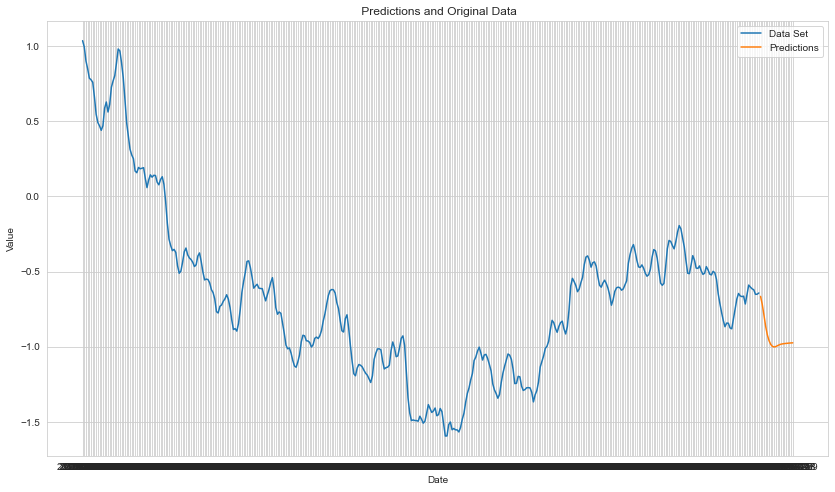

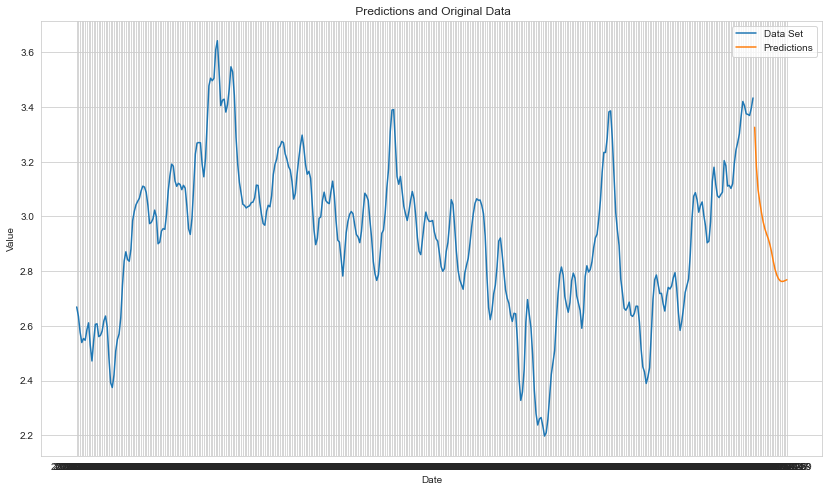

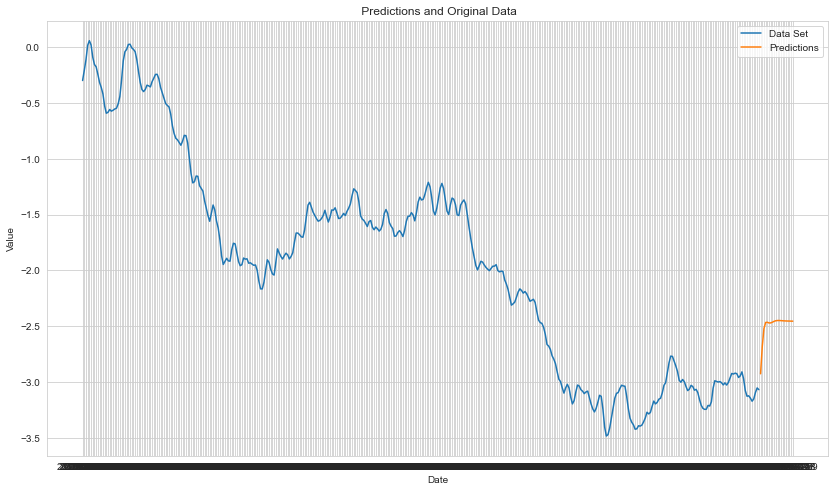

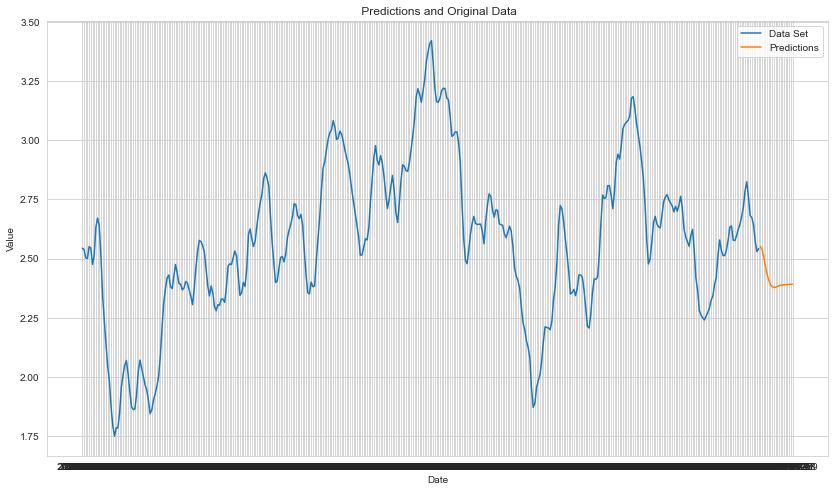

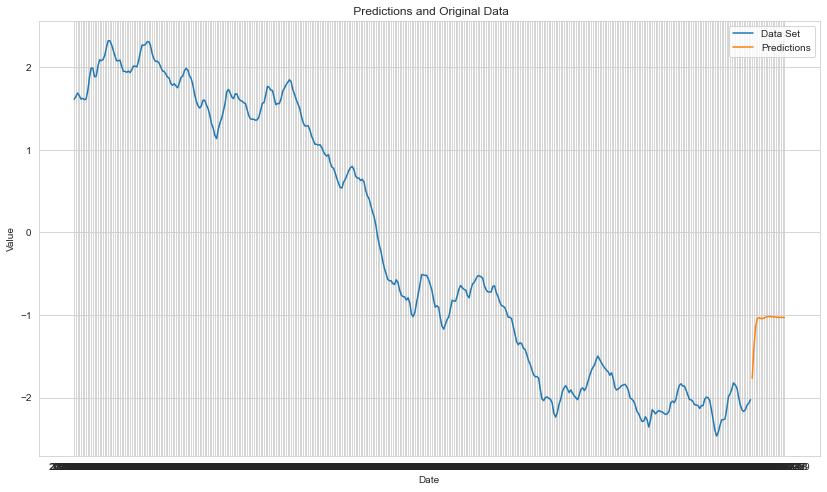

...

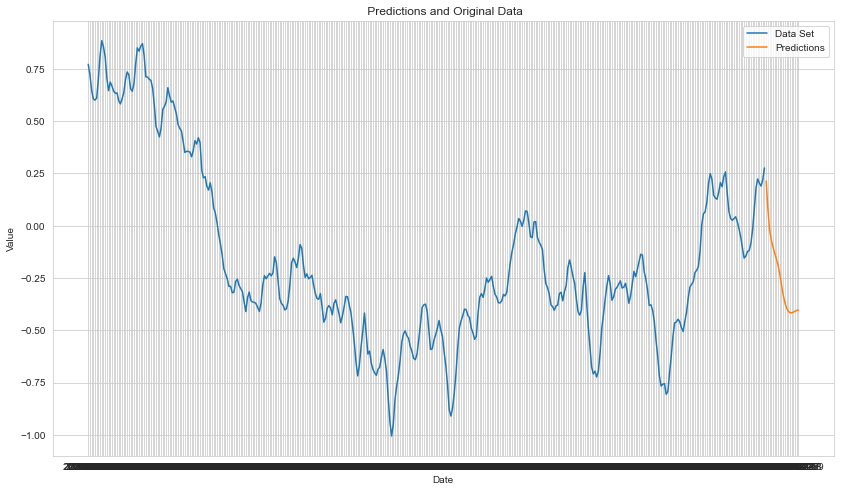

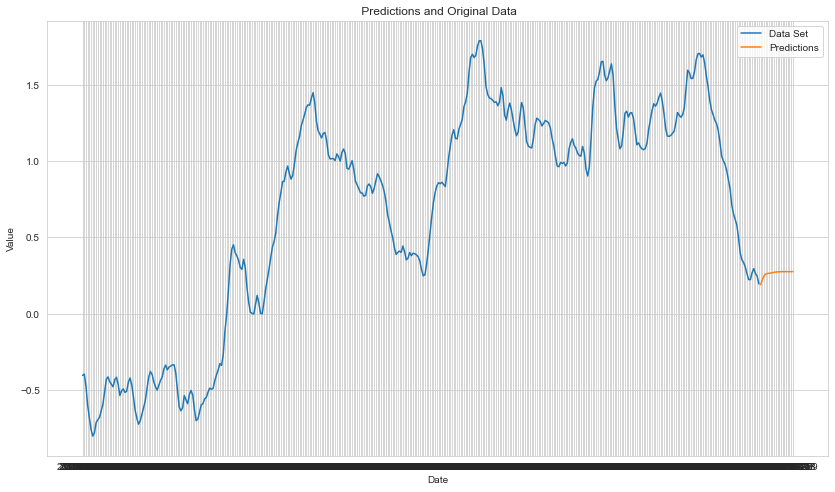

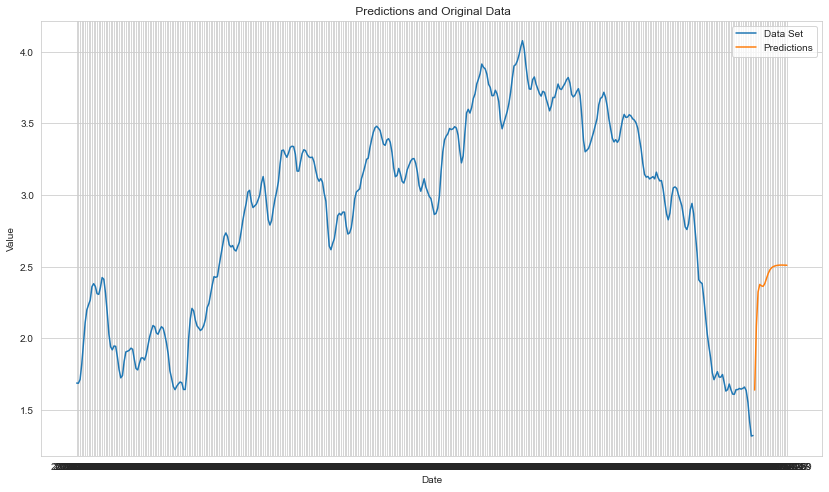

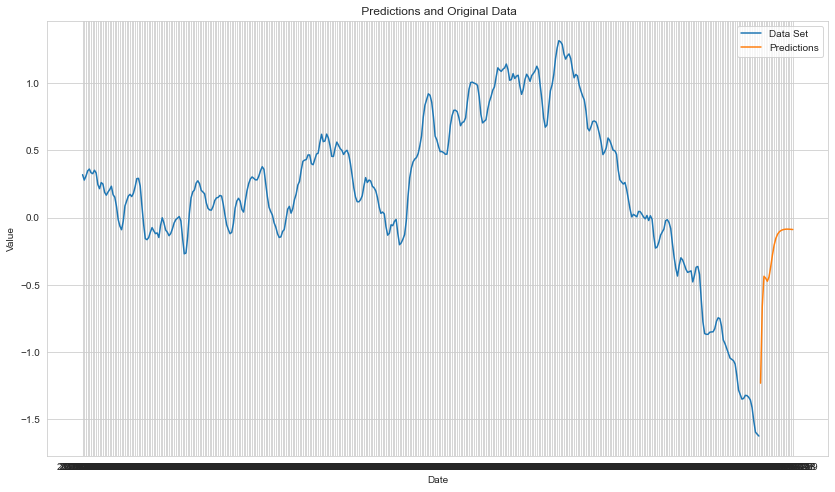

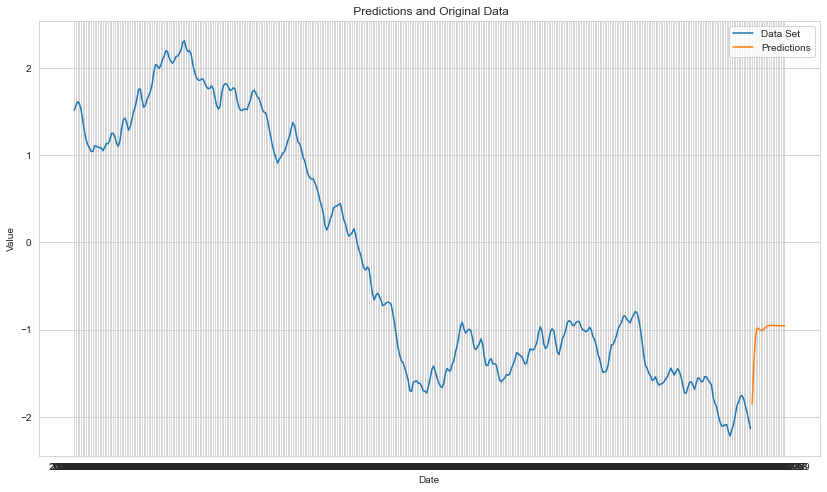

In [42]:
for ent in entity_list:
    plt.figure(figsize=(14,8))
    plt.plot(train_full_df[ent])
    plt.plot(market2_pred[ent])
    plt.ylabel("Value")
    plt.xlabel("Date")
    plt.legend(["Data Set", "Predictions"])
    plt.title(" Predictions and Original Data")